Trebuie gandit un mecanism in care sa se poata aplica exponential average pe SJF

In [116]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sqlite3

# Funcții

In [684]:
def get_df():
    cnx = sqlite3.connect('anon_jobs.db3')

    table_name = pd.read_sql_query("SELECT name FROM sqlite_master WHERE type='table';", cnx)
    # print(table_name)

    df = pd.read_sql_query("SELECT * FROM 'Jobs';", cnx)
    df = df.sort_values(by=['SubmitTime'], ascending=True)

    cnx.close()
    
    return df

def get_processed_df():
    df = get_df()
    constant_columns = [column for column in df.columns if df[column].nunique() == 1]

    df_processed = df.drop(constant_columns, axis=1)

    df_processed = df_processed.drop(['JobID'], axis=1)
    df_processed = df_processed.drop(['SubmitTime'], axis=1)
    df_processed = df_processed.drop(['RunTime'], axis=1)
    df_processed = df_processed.drop(['WaitTime'], axis=1)

    return df_processed

def preprocess_df(df: pd.DataFrame) -> pd.DataFrame:
    constant_columns = [column for column in df.columns if df[column].nunique() == 1]

    df_processed = df.drop(constant_columns, axis=1)

    df_processed = df_processed.drop(['JobID'], axis=1)
    df_processed = df_processed.drop(['SubmitTime'], axis=1)
    df_processed = df_processed.drop(['RunTime'], axis=1)
    df_processed = df_processed.drop(['WaitTime'], axis=1)

    return df_processed

In [732]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
def print_store_scores(model, X_test, Y_test) -> None:
    Y_pred = model.predict(X_test)

    print(f'Mean Squared Error: {mean_squared_error(Y_test, Y_pred)}')
    print(f'Root Mean Squared Error: {np.sqrt(mean_squared_error(Y_test, Y_pred))}')
    print(f'Mean Absolute Error: {mean_absolute_error(Y_test, Y_pred)}')
    print(f'R^2: {r2_score(Y_test, Y_pred)}')


In [140]:
import category_encoders as ce
def encode(X_train, Y_train, X_test, type: str = ('leave_one_out', 'target'), **kwargs):
    categorical_columns = X_train.select_dtypes(include='object').columns
    if type == 'leave_one_out':
        enc = ce.LeaveOneOutEncoder(cols=categorical_columns, return_df=True)
    elif type == 'target':
        enc = ce.TargetEncoder(cols=categorical_columns, return_df=True)
    else:
        raise ValueError('Invalid type')
    
    X_train = enc.fit_transform(X_train, Y_train, **kwargs)
    X_test = enc.transform(X_test)

    return X_train, X_test, enc

# Experiment: set #2

In [3]:
# cnx = sqlite3.connect('DRAFT.db3')

# table_name = pd.read_sql_query("SELECT name FROM sqlite_master WHERE type='table';", cnx)
# # print(table_name)

# df_secundar = pd.read_sql_query("SELECT * FROM 'Jobs';", cnx)

In [3]:
# # drop constant columns
# constant_columns = [col for col in df_secundar.columns if df_secundar[col].nunique() == 1]
# df_secundar = df_secundar.drop(constant_columns, axis=1)
# df_secundar.columns

# df_secundar = df_secundar.drop(['JobID'], axis=1)
# df_secundar = df_secundar.drop(['SubmitTime'], axis=1)
# df_secundar = df_secundar.drop(['RunTime'], axis=1)
# df_secundar = df_secundar.drop(['WaitTime'], axis=1)
# df_secundar = df_secundar.drop(['ReqMemory'], axis=1)
# df_secundar = df_secundar.drop(['PartitionID'], axis=1)

# df_secundar.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqTime', 'Status', 'UserID',
       'GroupID', 'ExecutableID', 'QueueID', 'OrigSiteID', 'LastRunSiteID'],
      dtype='object')

# Resume

In [117]:
cnx = sqlite3.connect('anon_jobs.db3')

table_name = pd.read_sql_query("SELECT name FROM sqlite_master WHERE type='table';", cnx)
# print(table_name)

df = pd.read_sql_query("SELECT * FROM 'Jobs';", cnx)

df.describe()

,JobID,SubmitTime,WaitTime,RunTime,NProc,UsedCPUTime,UsedMemory,ReqNProcs,ReqTime,ReqMemory,Status,UsedNetwork,UsedLocalDiskSpace,ReqNetwork,ReqLocalDiskSpace
count,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1124772.0,1.124772e+06,1124772.0,1124772.0,1124772.0,1124772.0
mean,5.623865e+05,1.141096e+09,4.317657e+02,3.697174e+02,4.306248e+00,3.405256e+01,4.589586e+04,4.306248e+00,4.655147e+03,-1.0,9.989669e-01,-1.0,-1.0,-1.0,-1.0
std,3.246939e+05,1.401233e+07,3.595336e+03,3.938101e+03,6.361762e+00,3.083070e+02,3.464246e+05,6.361762e+00,2.838875e+05,0.0,3.212525e-02,0.0,0.0,0.0,0.0
min,1.000000e+00,1.109088e+09,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,-1.000000e+00,-1.0,0.000000e+00,-1.0,-1.0,-1.0,-1.0
25%,2.811938e+05,1.130606e+09,4.000000e+00,1.500000e+01,1.000000e+00,1.000000e-02,4.276224e+03,1.000000e+00,9.000000e+02,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0
50%,5.623865e+05,1.140470e+09,6.000000e+00,4.700000e+01,2.000000e+00,3.000000e-02,6.348800e+03,2.000000e+00,9.000000e+02,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0
75%,8.435792e+05,1.149950e+09,1.400000e+01,1.460000e+02,4.000000e+00,8.000000e-02,1.044480e+04,4.000000e+00,9.600000e+02,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0
max,1.124772e+06,1.166002e+09,1.302269e+06,5.483630e+05,1.280000e+02,5.107015e+04,4.294951e+06,1.280000e+02,6.000000e+07,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0


In [104]:
df.head()

,JobID,SubmitTime,WaitTime,RunTime,NProc,UsedCPUTime,UsedMemory,ReqNProcs,ReqTime,ReqMemory,...,JobStructureParams,UsedNetwork,UsedLocalDiskSpace,UsedResources,ReqPlatform,ReqNetwork,ReqLocalDiskSpace,ReqResources,VOID,ProjectID
0,1,1109087545,9,21,1,0.05,8282.112,1,-1.0,-1.0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
1,2,1109087546,8,21,1,0.08,10485.760,1,-1.0,-1.0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
2,3,1109087609,5,1,1,0.00,2584.576,1,-1.0,-1.0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
3,4,1109091229,15,0,1,0.00,0.000,1,-1.0,-1.0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
4,5,1109091214,65162,1,1,0.00,0.000,1,-1.0,-1.0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1


In [7]:
df.columns

Index(['JobID', 'SubmitTime', 'WaitTime', 'RunTime', 'NProc', 'UsedCPUTime',
       'UsedMemory', 'ReqNProcs', 'ReqTime', 'ReqMemory', 'Status', 'UserID',
       'GroupID', 'ExecutableID', 'QueueID', 'PartitionID', 'OrigSiteID',
       'LastRunSiteID', 'JobStructure', 'JobStructureParams', 'UsedNetwork',
       'UsedLocalDiskSpace', 'UsedResources', 'ReqPlatform', 'ReqNetwork',
       'ReqLocalDiskSpace', 'ReqResources', 'VOID', 'ProjectID'],
      dtype='object')

In [312]:
constant_columns = [column for column in df.columns if df[column].nunique() == 1]

df_processed = df.drop(constant_columns, axis=1)

df_processed = df_processed.drop(['JobID'], axis=1)
df_processed = df_processed.drop(['SubmitTime'], axis=1)
df_processed = df_processed.drop(['RunTime'], axis=1)
df_processed = df_processed.drop(['WaitTime'], axis=1)

df_processed.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status',
       'UserID', 'GroupID', 'ExecutableID', 'QueueID', 'OrigSiteID',
       'LastRunSiteID', 'JobStructure', 'JobStructureParams'],
      dtype='object')

In [329]:
df_processed['total_cpu_time'] = df_processed.groupby('UsedCPUTime')['UsedCPUTime'].transform('sum')
sampled_df = df.sample(weights=df_processed['total_cpu_time'], n=1_000)

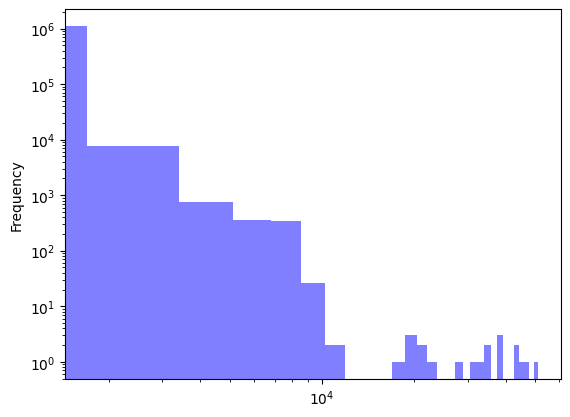

In [576]:
#plot the distribution of the sampled data
df['UsedCPUTime'].plot.hist(bins=30, alpha=0.5, color='blue', label='Original')
plt.xscale('log')
plt.yscale('log')
plt.show()

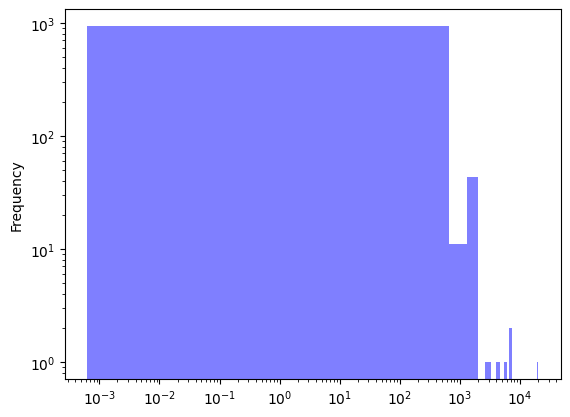

In [611]:
# get sub sample of the data with respect to the total cpu time
sampled_df = df.sample(weights=df.groupby('UsedCPUTime')['UsedCPUTime'].transform('sum'), n=1_000)

#plot the distribution of the sampled data
sampled_df['UsedCPUTime'].plot.hist(bins=30, alpha=0.5, color='blue', label='Sampled')
plt.xscale('log')
plt.yscale('log')
plt.show()

In [386]:
df_processed.dtypes

NProc                   int64
UsedCPUTime           float64
UsedMemory            float64
ReqNProcs               int64
ReqTime               float64
Status                  int64
UserID                 object
GroupID                object
ExecutableID           object
QueueID                object
OrigSiteID             object
LastRunSiteID          object
JobStructure           object
JobStructureParams     object
dtype: object

In [352]:
# get df_numeric
df_numeric = df_processed.select_dtypes(include=[np.number])
df_numeric.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status'], dtype='object')

In [353]:
# if reqTime < 0, set it to 0
df_numeric['ReqTime'] = df_numeric['ReqTime'].apply(lambda x: 0 if x < 0 else x)
df_numeric.shape

(1124772, 6)

In [362]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

X = df_numeric.drop('UsedCPUTime', axis=1).to_numpy()
y = df_numeric['UsedCPUTime']

# X = np.array([[1, 1, 3],
#               [0, 1, 5],
#               [5, 4, 1],
#               [6, 6, 2],
#               [1, 4, 0],
#               [0, 0, 0]])
# y = np.array([1, 1, 0, 0, 2, 2])
chi2_stats, p_values = chi2(X, y)

print(chi2_stats)
p_values

ValueError: Unknown label type: (0          0.050
1          0.080
2          0.000
3          0.000
4          0.000
           ...  
1124767    0.070
1124768    0.060
1124769    0.160
1124770    0.085
1124771    0.090
Name: UsedCPUTime, Length: 1124772, dtype: float64,)

In [17]:
len(df)

1124772

In [18]:
#count number of columns
num_cols = len(df.columns)
num_cols

29

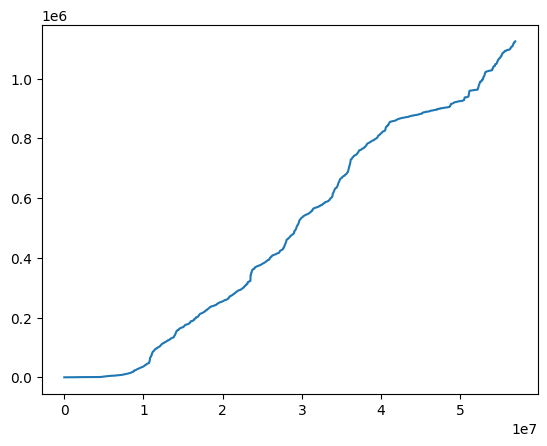

In [109]:
times = df['SubmitTime'].to_numpy()
times = np.sort(times)
times = times - times[0]

plt.plot(times, np.arange(len(times)))

In [135]:
times = df['SubmitTime'].to_numpy()
times = np.sort(times)
np.count_nonzero(times == df['SubmitTime'].values)

5676

In [10]:
df_sorted = df.sort_values(by='UsedCPUTime')

In [12]:
times = df_sorted['SubmitTime'].to_numpy()

In [ ]:
# get a sample acoording to distribution of times

In [22]:
sorted_times = np.sort(df['UsedCPUTime'])

In [23]:
sorted_times[10 ** 6]

0.19

# Trebuie precizat in paper cum s a efectuat subsampling ul; 1124772 / 30000 = # de sampling uri


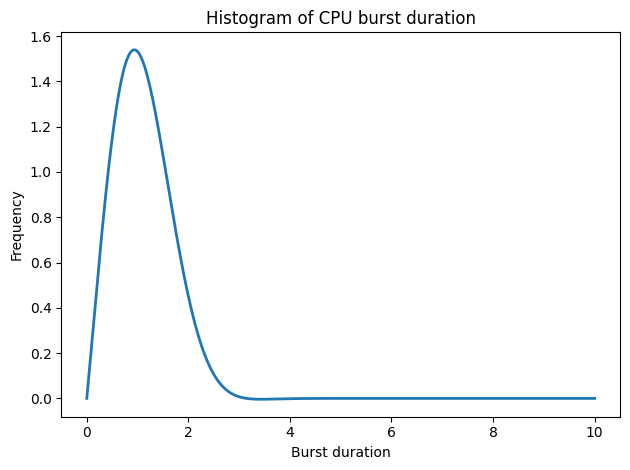

In [24]:
x = np.linspace(0, 10, 400)

# Define a function that approximates the shape of the CPU burst duration histogram
def burst_duration_function(x):
    return np.sin(x) * np.exp(-.5 * (x - .2) ** 2) * np.sqrt(2 * np.pi)

# Calculate the y values (frequency) using the function
y = burst_duration_function(x)

# Plot the function
plt.plot(x, y, linewidth=2)

# Add labels and title
plt.xlabel('Burst duration')
plt.ylabel('Frequency')
plt.title('Histogram of CPU burst duration')

plt.tight_layout()

# Display the plot
plt.show()


De selectat unix time aleator pentru simulare. Se ia un chunck

De parcurs seria de timp, de la cap, pana la coada.

Pentru antrenare iau un proces

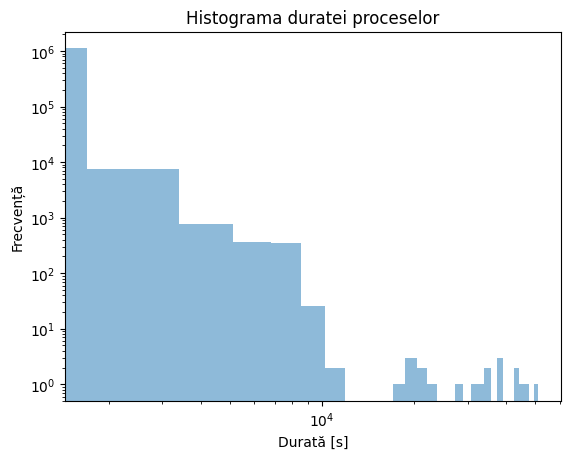

In [9]:
#plot histogram of job durations

# df.plot

df['UsedCPUTime'].plot.hist(bins=30, alpha=0.5)
# df['UsedCPUTime'].plot.hist(bins=10, alpha=0.8)
plt.yscale('log')
plt.xscale('log')
plt.xlabel('Durată [s]')
plt.ylabel('Frecvență')
plt.title('Histograma duratei proceselor')
# plt.show()

plt.savefig('job_durations.pdf')

In [ ]:
# get frequency of job durations with bins of 10^x

0x0. log x pe Ox mai multe bins...

0x1. de lasat runtime. De adaugat histograma pt nr de procese active concomitent. 

Scheduler ul este cel mai important in momentul in care sunt cat mai multe procese simultan

0x2. de luat de pe net codu pentru CFS. Brain Duck scheduler. SJF, SRTF, RR. EXPERIMENTAL: sisteme in timp real: Real time scheduler

0x3. de inteles categoria pentru procese

De facut o sortare pentru scheduler. Nu neaparat regresie, mai de graba de facut o sortare

De Explicat de ce nu merge SJF

Setul de date este limitat

Mult prea multa granularitate -> ar fi dificil sa creem un scheduler 

Monitorizarea in timp real nu poate fi eficienta. 

De modelat Context Switch ul

Burst time random pentru sistemul de operare. 

In [ ]:
# de 

# joaca

In [26]:
#get name of columns
df.columns

Index(['JobID', 'SubmitTime', 'WaitTime', 'RunTime', 'NProc', 'UsedCPUTime',
       'UsedMemory', 'ReqNProcs', 'ReqTime', 'ReqMemory', 'Status', 'UserID',
       'GroupID', 'ExecutableID', 'QueueID', 'PartitionID', 'OrigSiteID',
       'LastRunSiteID', 'JobStructure', 'JobStructureParams', 'UsedNetwork',
       'UsedLocalDiskSpace', 'UsedResources', 'ReqPlatform', 'ReqNetwork',
       'ReqLocalDiskSpace', 'ReqResources', 'VOID', 'ProjectID'],
      dtype='object')

In [12]:
constant_columns = [column for column in df.columns if df[column].nunique() == 1]
print(f'The number of constant columns is: {len(constant_columns)}')
constant_columns

The number of constant columns is: 11


['ReqMemory',
 'PartitionID',
 'UsedNetwork',
 'UsedLocalDiskSpace',
 'UsedResources',
 'ReqPlatform',
 'ReqNetwork',
 'ReqLocalDiskSpace',
 'ReqResources',
 'VOID',
 'ProjectID']

Dropped 11 columns that have only one unique value. There are 18 columns left.

In [13]:
df = df.drop(constant_columns, axis=1)
df.describe()

,JobID,SubmitTime,WaitTime,RunTime,NProc,UsedCPUTime,UsedMemory,ReqNProcs,ReqTime,Status
count,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06
mean,5.623865e+05,1.141096e+09,4.317657e+02,3.697174e+02,4.306248e+00,3.405256e+01,4.589586e+04,4.306248e+00,4.655147e+03,9.989669e-01
std,3.246939e+05,1.401233e+07,3.595336e+03,3.938101e+03,6.361762e+00,3.083070e+02,3.464246e+05,6.361762e+00,2.838875e+05,3.212525e-02
min,1.000000e+00,1.109088e+09,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,-1.000000e+00,0.000000e+00
25%,2.811938e+05,1.130606e+09,4.000000e+00,1.500000e+01,1.000000e+00,1.000000e-02,4.276224e+03,1.000000e+00,9.000000e+02,1.000000e+00
50%,5.623865e+05,1.140470e+09,6.000000e+00,4.700000e+01,2.000000e+00,3.000000e-02,6.348800e+03,2.000000e+00,9.000000e+02,1.000000e+00
75%,8.435792e+05,1.149950e+09,1.400000e+01,1.460000e+02,4.000000e+00,8.000000e-02,1.044480e+04,4.000000e+00,9.600000e+02,1.000000e+00
max,1.124772e+06,1.166002e+09,1.302269e+06,5.483630e+05,1.280000e+02,5.107015e+04,4.294951e+06,1.280000e+02,6.000000e+07,1.000000e+00


In [311]:
df_processed.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status',
       'UserID', 'GroupID', 'ExecutableID', 'QueueID', 'OrigSiteID',
       'LastRunSiteID', 'JobStructure', 'JobStructureParams'],
      dtype='object')

In [26]:
df[['NProc', 'UsedCPUTime']].sample(10)

#de schimbat in timp total?

,NProc,UsedCPUTime
143028,2,0.010000
1090790,2,0.075000
365383,6,0.041667
193051,2,0.015000
970852,1,8.720000
1086396,9,0.046667
1029563,2,0.085000
386168,2,0.005000
134085,15,0.024667
587958,16,0.000625


In [27]:
np.min(df['SubmitTime'])    #Tue Feb 22 2005

1109087545

In [28]:
np.max(df['SubmitTime'])    #Wed Dec 13 2006

1166002188

De verificat care este asocierea intre procesele daemon si low PID

In [29]:
#1
df = df.drop('SubmitTime', axis=1)

In [40]:
#2
df = df.drop('JobID', axis=1)

In [30]:
#3

df['GroupID'].unique()

array(['G0', 'G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'G10',
       'G11'], dtype=object)

In [31]:
print(np.max(df['RunTime']))
np.max(df['UsedCPUTime'])

548363


51070.15

In [32]:
df = df.drop('RunTime', axis=1)

Doing some encoding on categorical data

In [86]:
import sklearn
sklearn.set_config(transform_output="pandas")
import category_encoders as ce

# df_X = df.drop('UsedCPUTime', axis=1)

enc = ce.LeaveOneOutEncoder(cols=df.columns).fit(df, df['UsedCPUTime'])

In [87]:
df_numeric = enc.transform(df)

In [88]:
df_numeric.head()

,WaitTime,NProc,UsedCPUTime,UsedMemory,ReqNProcs,ReqTime,Status,UserID,GroupID,ExecutableID,QueueID,OrigSiteID,LastRunSiteID,JobStructure,JobStructureParams
0,4.430694,99.408201,0.05,0.077222,99.408201,0.2876,34.087428,0.019765,4.999054,0.042,34.065079,1.194788,1.194788,1.498169,1.498169
1,9.213555,99.408201,0.08,0.060833,99.408201,0.2876,34.087428,0.019765,4.999054,0.042,34.065079,1.194788,1.194788,1.498169,1.498169
2,26.200649,99.408201,0.00,0.012667,99.408201,0.2876,34.087428,0.019765,4.999054,0.000,34.065079,1.194788,1.194788,1.498169,1.498169
3,2.662485,99.408201,0.00,0.002911,99.408201,0.2876,34.087428,0.019765,4.999054,0.000,34.065079,1.194788,1.194788,1.498169,1.498169
4,34.052562,99.408201,0.00,0.002911,99.408201,0.2876,34.087428,0.019765,4.999054,0.000,34.065079,1.194788,1.194788,1.498169,1.498169


In [70]:
from sklearn.datasets import fetch_openml

bunch = fetch_openml(name="house_prices", as_frame=True)

display_cols = ["Id", "MSSubClass", "MSZoning", "LotFrontage", "YearBuilt", "Heating", "CentralAir"]

y = bunch.target
X = pd.DataFrame(bunch.data, columns=bunch.feature_names)[display_cols]
# enc = ce.LeaveOneOutEncoder(cols=['CentralAir', 'Heating']).fit(X, y)
# numeric_dataset = enc.transform(X)

# numeric_dataset.head()

In [33]:
df.sample(10)

,JobID,WaitTime,NProc,UsedCPUTime,UsedMemory,ReqNProcs,ReqTime,ReqMemory,Status,UserID,...,JobStructureParams,UsedNetwork,UsedLocalDiskSpace,UsedResources,ReqPlatform,ReqNetwork,ReqLocalDiskSpace,ReqResources,VOID,ProjectID
117348,117349,14,2,0.010000,4782.080000,2,960.0,-1.0,1,U84,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
1059947,1059948,2,3,0.070000,7525.717333,3,900.0,-1.0,1,U66,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
523674,523675,11,1,0.030000,3973.120000,1,900.0,-1.0,1,U86,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
254335,254336,7,4,0.005000,2392.064000,4,960.0,-1.0,1,U0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
119288,119289,3,1,0.020000,9568.256000,1,960.0,-1.0,1,U0,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
97555,97556,15,13,0.024615,3438.434462,13,900.0,-1.0,1,U69,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
411843,411844,50,2,0.020000,4784.128000,2,960.0,-1.0,1,U84,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
167587,167588,11,2,0.010000,4788.224000,2,960.0,-1.0,1,U84,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
1109842,1109843,4,13,0.025385,2768.265846,13,900.0,-1.0,1,U173,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1
99623,99624,17,2,0.010000,4786.176000,2,960.0,-1.0,1,U84,...,-1,-1.0,-1.0,-1,-1,-1.0,-1.0,-1,-1,-1


In [77]:
X.sample(10)

,Id,MSSubClass,MSZoning,LotFrontage,YearBuilt,Heating,CentralAir
1081,1082,20,RL,75.0,1963,GasA,Y
1307,1308,20,RL,60.0,1994,GasA,Y
344,345,160,RM,36.0,1976,GasA,Y
885,886,120,FV,50.0,1999,GasA,Y
1149,1150,70,RM,50.0,1920,GasA,Y
1207,1208,20,RL,70.0,2003,GasA,Y
1126,1127,120,RL,53.0,2007,GasA,Y
360,361,85,RL,NaN,1978,GasA,Y
1199,1200,20,RL,75.0,1963,GasA,Y
1094,1095,20,RL,74.0,1956,GasA,Y


In [34]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split

import random

# Extracting the training data

In [35]:
len(df)

1124772

In [36]:
# show all column types
df.dtypes

JobID                   int64
WaitTime                int64
NProc                   int64
UsedCPUTime           float64
UsedMemory            float64
ReqNProcs               int64
ReqTime               float64
ReqMemory             float64
Status                  int64
UserID                 object
GroupID                object
ExecutableID           object
QueueID                object
PartitionID            object
OrigSiteID             object
LastRunSiteID          object
JobStructure           object
JobStructureParams     object
UsedNetwork           float64
UsedLocalDiskSpace    float64
UsedResources          object
ReqPlatform            object
ReqNetwork            float64
ReqLocalDiskSpace     float64
ReqResources           object
VOID                   object
ProjectID              object
dtype: object

In [37]:
df['ExecutableID'].value_counts()   # maybe we can drop this column

ExecutableID
X14      531249
X17      368387
X116      92325
X95       89416
X8954      6249
          ...  
X5821         1
X5820         1
X5819         1
X5818         1
X9069         1
Name: count, Length: 9070, dtype: int64

In [76]:
df['QueueID'].unique()

array(['Q0', 'Q1', 'Q2'], dtype=object)

In [77]:
df['OrigSiteID'].unique()

array(['DAS2/fs0', 'DAS2/fs1', 'DAS2/fs2', 'DAS2/fs3', 'DAS2/fs4'],
      dtype=object)

In [78]:
df['LastRunSiteID'].unique()

array(['DAS2/fs0', 'DAS2/fs1', 'DAS2/fs2', 'DAS2/fs3', 'DAS2/fs4'],
      dtype=object)

In [79]:
df['JobStructure'].unique()

array(['UNITARY', 'BoT'], dtype=object)

In [80]:
df['JobStructureParams'].value_counts() # maybe we can drop this column

JobStructureParams
-1          1019232
fs336931       7000
fs336936       6995
fs336960       6000
fs344294       4943
             ...   
fs315384          1
fs315385          1
fs315380          1
fs315377          1
fs314770          1
Name: count, Length: 1957, dtype: int64

In [81]:
df['OrigSiteID'].value_counts()

OrigSiteID
DAS2/fs0    536583
DAS2/fs3    227809
DAS2/fs2    139162
DAS2/fs4    116977
DAS2/fs1    104241
Name: count, dtype: int64

In [82]:
df['ExecutableID'].value_counts()   # maybe we can drop this column

ExecutableID
X14      531249
X17      368387
X116      92325
X95       89416
X8954      6249
          ...  
X5821         1
X5820         1
X5819         1
X5818         1
X9069         1
Name: count, Length: 9070, dtype: int64

In [83]:
# print all userID
# count unique values
df['UserID'].value_counts()  # maybe we can drop this column

UserID
U66     201088
U84     144876
U239     94323
U173     89417
U6       69363
         ...  
U202         1
U25          1
U181         1
U109         1
U332         1
Name: count, Length: 333, dtype: int64

In [38]:
#if columns does not contain a number, we can drop it
for column in df.columns:
    if df[column].dtype == 'object':
        df = df.drop(column, axis=1)

In [39]:
df.columns

Index(['JobID', 'WaitTime', 'NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs',
       'ReqTime', 'ReqMemory', 'Status', 'UsedNetwork', 'UsedLocalDiskSpace',
       'ReqNetwork', 'ReqLocalDiskSpace'],
      dtype='object')

In [140]:
sampling_seed:int = 3912

In [40]:
df.describe()

,JobID,WaitTime,NProc,UsedCPUTime,UsedMemory,ReqNProcs,ReqTime,ReqMemory,Status,UsedNetwork,UsedLocalDiskSpace,ReqNetwork,ReqLocalDiskSpace
count,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1.124772e+06,1124772.0,1.124772e+06,1124772.0,1124772.0,1124772.0,1124772.0
mean,5.623865e+05,4.317657e+02,4.306248e+00,3.405256e+01,4.589586e+04,4.306248e+00,4.655147e+03,-1.0,9.989669e-01,-1.0,-1.0,-1.0,-1.0
std,3.246939e+05,3.595336e+03,6.361762e+00,3.083070e+02,3.464246e+05,6.361762e+00,2.838875e+05,0.0,3.212525e-02,0.0,0.0,0.0,0.0
min,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,-1.000000e+00,-1.0,0.000000e+00,-1.0,-1.0,-1.0,-1.0
25%,2.811938e+05,4.000000e+00,1.000000e+00,1.000000e-02,4.276224e+03,1.000000e+00,9.000000e+02,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0
50%,5.623865e+05,6.000000e+00,2.000000e+00,3.000000e-02,6.348800e+03,2.000000e+00,9.000000e+02,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0
75%,8.435792e+05,1.400000e+01,4.000000e+00,8.000000e-02,1.044480e+04,4.000000e+00,9.600000e+02,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0
max,1.124772e+06,1.302269e+06,1.280000e+02,5.107015e+04,4.294951e+06,1.280000e+02,6.000000e+07,-1.0,1.000000e+00,-1.0,-1.0,-1.0,-1.0


In [169]:
df_sample = df_processed.sample(n=30_000, random_state=sampling_seed)

In [208]:
df_sample = df_processed.copy()

In [209]:
df_sample['UsedCPUTime']

0          0.050
1          0.080
2          0.000
3          0.000
4          0.000
           ...  
1124767    0.070
1124768    0.060
1124769    0.160
1124770    0.085
1124771    0.090
Name: UsedCPUTime, Length: 1124772, dtype: float64

In [210]:
seed: int = 42

In [211]:
len(df_sample)

1124772

# Only numerical columns

In [78]:
df_sample = df_processed.sample(n=240_000, random_state=sampling_seed)
df_sample.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status',
       'UserID', 'GroupID', 'ExecutableID', 'QueueID', 'OrigSiteID',
       'LastRunSiteID', 'JobStructure', 'JobStructureParams'],
      dtype='object')

In [79]:
#get rid of non-numeric columns
for column in df_sample.columns:
    if df_sample[column].dtype == 'object':
        df_sample = df_sample.drop(column, axis=1)

df_sample.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status'], dtype='object')

In [80]:
#get 80 percent training data
from sklearn.model_selection import train_test_split

target = 'UsedCPUTime'

X = df_sample.drop(target, axis=1)
Y = df_sample[target]

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=seed)

In [82]:
# https://pandas.pydata.org/docs/reference/api/pandas.Categorical.codes.html

from sklearn.neighbors import KNeighborsRegressor

sol = []

for k in range(1, 100):
    model = KNeighborsRegressor(n_neighbors=k)
    model.fit(X_train, Y_train)
    sol.append(model.score(X_test, Y_test))
    print(k, sol[-1])

plt.plot(sol)
plt.show()

n = np.argmax(sol) + 1

1 0.40956070159144886
2 0.49983346442152476
3 0.46743856336299083
4 0.48618239902043137
5 0.5031305754878272
6 0.5282505836493783
7 0.5438247935303164
8 0.5598160430129213
9 0.5718603115163319
10 0.5736607350275489
11 0.576358698120611
12 0.5787161671059786
13 0.5751454646999179
14 0.5745605715072843
15 0.5764386046090726
16 0.5744540998826028
17 0.5725164702415035
18 0.5700426434809867


KeyboardInterrupt: 

In [779]:
neigh.score(X_test, Y_test)

0.5682585416028314

Densitatea cloud ului de sus Vs. densitatea cloud ului de jos


Histograma pe x (diferenta de timp).
pe Y histograma. 

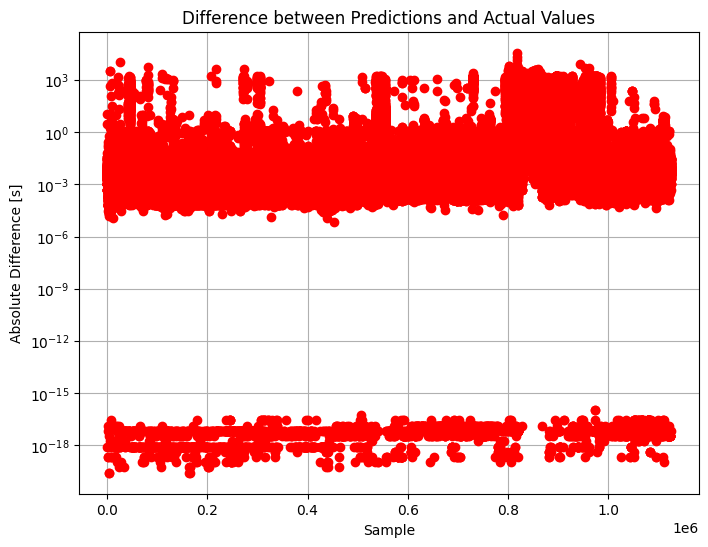

In [219]:
def plot_prediction_differences(model, X_test, Y_test):
    predictions = model.predict(X_test)
    differences = np.abs(predictions - Y_test)

    plt.figure(figsize=(8, 6))
    plt.semilogy(differences, color='r', marker='o', linestyle='None')
    plt.xlabel('Sample')
    plt.ylabel('Absolute Difference [s]')
    plt.title('Difference between Predictions and Actual Values')
    plt.grid(True)
    plt.show()

plot_prediction_differences(neigh, X_test, Y_test)

In [455]:
from sklearn.ensemble import RandomForestRegressor

forest = RandomForestRegressor(random_state=seed)

forest.fit(X_train, Y_train)

RandomForestRegressor(random_state=982112938)

In [456]:
forest.score(X_test, Y_test)

0.90688390553634

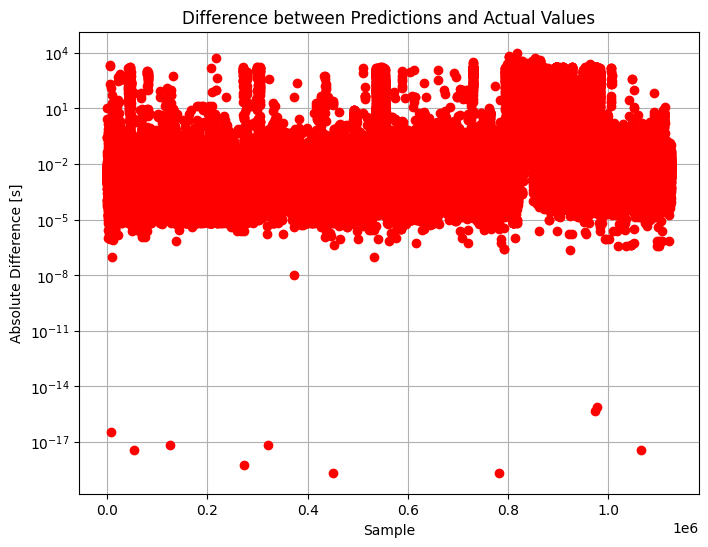

In [222]:
plot_prediction_differences(forest, X_test, Y_test)

In [457]:
from sklearn.tree import DecisionTreeRegressor

tree = DecisionTreeRegressor(random_state=seed)

tree.fit(X_train, Y_train)

DecisionTreeRegressor(random_state=982112938)

In [458]:

tree.score(X_test, Y_test)

0.9562790594057758

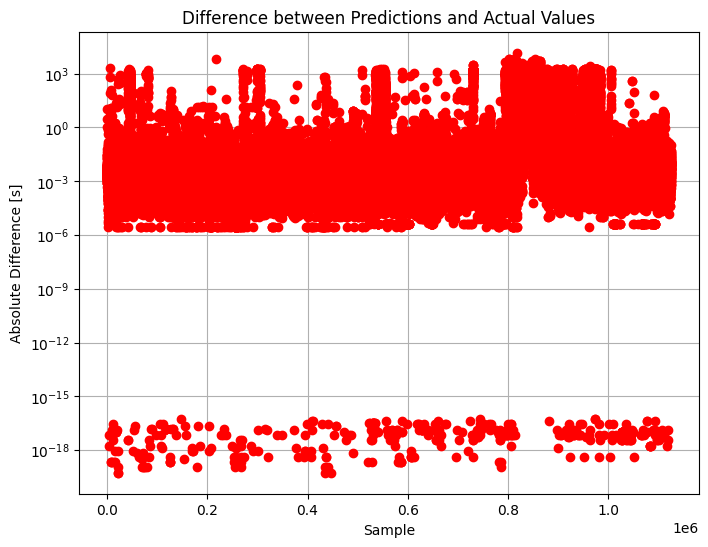

In [225]:
plot_prediction_differences(tree, X_test, Y_test)

In [83]:
#xgboost 
import xgboost as xgb

sol = []

for n in range(1, 100):
    xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', n_estimators=n)
    xg_reg.fit(X_train, Y_train)
    sol.append(xg_reg.score(X_test, Y_test))
    print(n, ': ', sol[-1])

xg_reg.fit(X_train, Y_train)

1 :  0.32743593579628505
2 :  0.46299403050921006
3 :  0.5356245153252766
4 :  0.5804670755713136
5 :  0.5976513595591881
6 :  0.6062394227726007
7 :  0.6107183285802322
8 :  0.6129682600399999
9 :  0.6139519932689254
10 :  0.614331314826904
11 :  0.6146524493177303
12 :  0.614779292928803
13 :  0.6147724387198663
14 :  0.61468201730424
15 :  0.6144097027873028
16 :  0.6143631253128068
17 :  0.6143396438183144
18 :  0.6143121111418302
19 :  0.6142343792777571
20 :  0.6141395230815947
21 :  0.6141176549413254
22 :  0.6140984793891819
23 :  0.6140814494665903
24 :  0.6140733425318526
25 :  0.6140649115824555
26 :  0.6142752820479456
27 :  0.6142658059302131
28 :  0.6142600808138305
29 :  0.6142779652323158
30 :  0.6141380161870946
31 :  0.6141119494987276
32 :  0.6141087541333817
33 :  0.6141064691745923
34 :  0.6140504322347857
35 :  0.614003738112264
36 :  0.6140018502908873
37 :  0.6140615021908411
38 :  0.6140137335486692
39 :  0.6140114693228106
40 :  0.6140098816967297
41 :  0.6140

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=99, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [88]:
X_final = df.drop([target], axis=1)

for column in X_final.columns:
    if X_final[column].dtype == 'object':
        X_final = X_final.drop(column, axis=1)


Y_final = df[target]
xg_reg.score(X_final, Y_final)

ValueError: feature_names mismatch: ['NProc', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status'] ['JobID', 'SubmitTime', 'WaitTime', 'RunTime', 'NProc', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'ReqMemory', 'Status', 'UsedNetwork', 'UsedLocalDiskSpace', 'ReqNetwork', 'ReqLocalDiskSpace']
training data did not have the following fields: UsedNetwork, WaitTime, SubmitTime, ReqLocalDiskSpace, JobID, RunTime, ReqNetwork, UsedLocalDiskSpace, ReqMemory

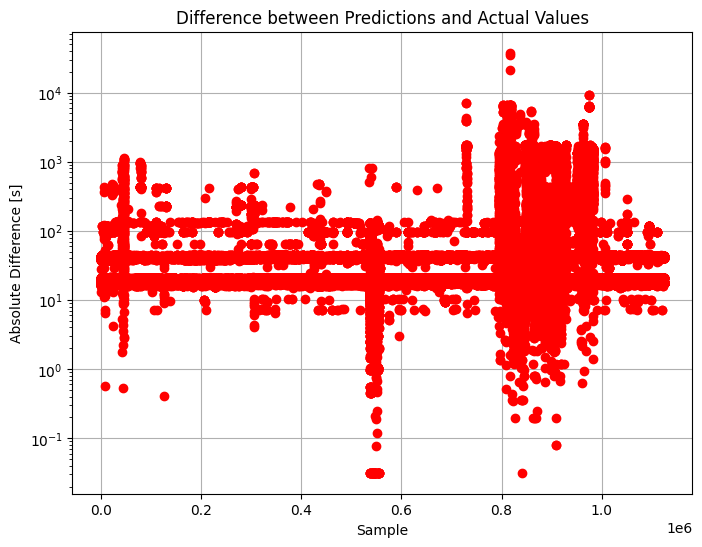

In [228]:
plot_prediction_differences(xg_reg, X_test, Y_test)

# DF with LeaveOneOut Encoding

In [823]:
sampling_seed: int = 1970

In [824]:
seed: int = 1233123

In [825]:
df_processed = get_processed_df()

In [826]:
#get 80 percent training data
from sklearn.model_selection import train_test_split

df_sample = df_processed.sample(weights=df_processed.groupby('UsedCPUTime')['UsedCPUTime'].transform('sum'), frac=0.1, random_state=sampling_seed)
target = 'UsedCPUTime'

X = df_sample.drop(target, axis=1)
Y = df_sample[target]

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=seed)

In [827]:
# get the categorical columns
categorical_columns = [column for column in X_train.columns if X_train[column].dtype == 'object']
categorical_columns

['UserID',
 'GroupID',
 'ExecutableID',
 'QueueID',
 'OrigSiteID',
 'LastRunSiteID',
 'JobStructure',
 'JobStructureParams']

In [828]:
import category_encoders as ce
encoder = ce.LeaveOneOutEncoder(cols=categorical_columns, return_df=True, sigma=0.5, random_state=seed)
X_train_loo = encoder.fit_transform(X_train, Y_train)
X_train_loo.head()

,NProc,UsedMemory,ReqNProcs,ReqTime,Status,UserID,GroupID,ExecutableID,QueueID,OrigSiteID,LastRunSiteID,JobStructure,JobStructureParams
135278,2,4784.128,2,960.0,1,0.011901,0.826504,0.025575,141.950899,2.270433,0.969069,9.283354,11.619864
924958,2,6307.840,2,600.0,1,0.108344,241.164126,0.048444,-13.085405,106.028913,303.494565,11.273175,11.571547
671421,2,12519.424,2,900.0,1,0.044209,0.036475,0.128907,82.855540,28.916172,18.943662,14.911619,14.276160
136244,2,4782.080,2,960.0,1,0.014896,0.742552,0.021352,106.809626,1.268439,0.767790,16.671202,11.726942
57701,1,9555.968,1,960.0,1,0.014087,0.391292,0.005427,92.041596,2.088545,0.229989,14.021089,8.819026


In [655]:
X_train_loo.dtypes

NProc                   int64
UsedMemory            float64
ReqNProcs               int64
ReqTime               float64
Status                  int64
UserID                float64
GroupID               float64
ExecutableID          float64
QueueID               float64
OrigSiteID            float64
LastRunSiteID         float64
JobStructure          float64
JobStructureParams    float64
dtype: object

In [465]:
X_train_loo.describe()

,NProc,UsedMemory,ReqNProcs,ReqTime,Status,UserID,GroupID,ExecutableID,QueueID,OrigSiteID,LastRunSiteID,JobStructure,JobStructureParams
count,24000.000000,2.400000e+04,24000.000000,2.400000e+04,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000,24000.000000
mean,1.470458,8.096877e+04,1.470458,9.625653e+03,0.999625,177.007500,176.963928,190.281468,176.791173,176.455927,177.709922,176.788213,165.225334
std,1.455295,3.698781e+05,1.455295,6.710838e+05,0.019362,492.837950,156.844729,638.672620,87.731216,213.293246,214.038699,238.222168,949.018382
min,1.000000,0.000000e+00,1.000000,-1.000000e+00,0.000000,-1681.490348,-255.881134,-1297.103884,-179.450320,-460.718385,-327.979586,-397.441243,-3380.711183
25%,1.000000,8.893440e+03,1.000000,9.000000e+02,1.000000,0.045438,0.545379,0.057949,118.608033,1.335686,1.338414,13.249536,12.250576
50%,1.000000,3.891200e+04,1.000000,9.000000e+02,1.000000,40.349646,181.523001,52.705134,176.689036,54.779266,55.464275,22.069797,19.891334
75%,1.000000,6.642074e+04,1.000000,9.000000e+02,1.000000,211.719148,298.183108,230.018683,236.331176,341.267206,345.037726,353.653224,46.280131
max,32.000000,4.292252e+06,32.000000,6.000000e+07,1.000000,7661.778137,692.244685,15570.703121,540.712822,1045.492323,1015.264532,1283.919012,52598.587822


In [829]:
X_test_loo = encoder.transform(X_test)
X_test_loo.describe()

,NProc,UsedMemory,ReqNProcs,ReqTime,Status,UserID,GroupID,ExecutableID,QueueID,OrigSiteID,LastRunSiteID,JobStructure,JobStructureParams
count,22496.000000,2.249600e+04,22496.000000,2.249600e+04,22496.000000,22496.000000,22496.000000,22496.000000,22496.000000,22496.000000,22496.000000,22496.000000,22496.000000
mean,1.621310,7.860909e+04,1.621310,4.841355e+03,0.999022,136.835383,137.177389,139.577466,137.779043,137.761657,137.761657,137.583311,129.269617
std,1.708951,3.969085e+05,1.708951,4.003042e+05,0.031258,331.742090,107.657733,414.287520,2.485675,149.204154,149.204154,177.355172,646.995959
min,1.000000,0.000000e+00,1.000000,-1.000000e+00,0.000000,0.004875,0.025038,0.009643,0.021806,0.076902,0.076902,9.529299,0.016667
25%,1.000000,7.196672e+03,1.000000,9.000000e+02,1.000000,0.036168,0.789099,0.072749,137.825397,1.274045,1.274045,9.529299,9.529299
50%,1.000000,1.422746e+04,1.000000,9.000000e+02,1.000000,0.092589,222.278603,0.072749,137.825397,39.848658,39.848658,9.529299,9.529299
75%,2.000000,6.584730e+04,2.000000,9.000000e+02,1.000000,218.898050,222.278603,218.943202,137.825397,316.803490,316.803490,383.209811,36.188379
max,32.000000,4.294087e+06,32.000000,6.000000e+07,1.000000,1840.048899,222.278603,7002.077226,137.825397,316.803490,316.803490,383.209811,34643.195000


In [830]:
X_total_loo = encoder.transform(X)
Y_total = Y

## KNN Regressor

In [790]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV

knn = KNeighborsRegressor(n_neighbors=5, p=1)

# param_grid = {
#     'n_neighbors': np.arange(1, 100),
#     'weights': ['uniform', 'distance'],
#     'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
#     'p': [1, 2]
# }

# grid_search = GridSearchCV(knn, param_grid, cv=5, n_jobs=-1, verbose=10, scoring='neg_root_mean_squared_error')
# grid_search.fit(X_train_loo, Y_train)

# knn = KNeighborsRegressor(**grid_search.best_params_)

knn.fit(X_train_loo, Y_train)

knn.score(X_test_loo, Y_test)

0.7009358017098613

In [791]:
X_total = df_processed.drop(target, axis=1)
X_total_loo = encoder.transform(X_total)
Y_total = df_processed[target]

In [792]:
# knn = KNeighborsRegressor(**grid_search.best_params_)
# knn.fit(X_train_loo, Y_train)

print('Sampled data')
print_store_scores(knn, X_test_loo, Y_test)

print('\nTotal data')

print_store_scores(knn, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 127010.73104751197
Root Mean Squared Error: 356.38564932880223
Mean Absolute Error: 49.13929078231494
R^2: 0.7009358017098613

Total data
Mean Squared Error: 33587.684393088646
Root Mean Squared Error: 183.26943114739197
Mean Absolute Error: 15.946816970939421
R^2: 0.6466431247384776


In [793]:
#save knn predictions
Y_pred = knn.predict(X_total_loo)
np.save('predictions_10_knn_loo_0.646.npy', Y_pred)

In [794]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(X_train_loo, Y_train)
print('Sampled data')

print_store_scores(lin_reg, X_test_loo, Y_test)

print('\nTotal data')

print_store_scores(lin_reg, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 57402.93379705964
Root Mean Squared Error: 239.58909365215194
Mean Absolute Error: 74.86174055849035
R^2: 0.864836913905348

Total data
Mean Squared Error: 17142.034242586866
Root Mean Squared Error: 130.92759160156757
Mean Absolute Error: 26.805223125690983
R^2: 0.8196584323975333


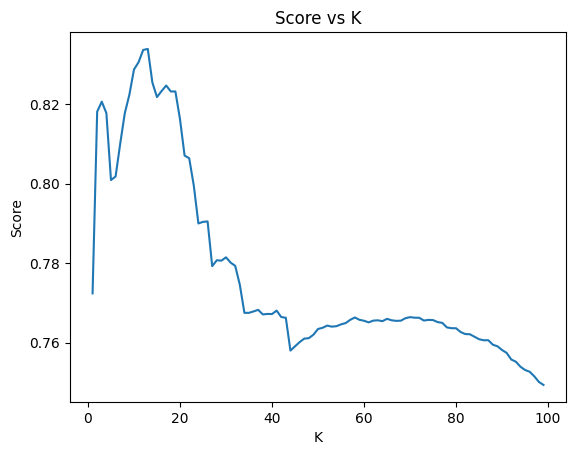

13

In [376]:
# plot the results
plt.plot(range(1, 100), sol)
plt.xlabel('K')
plt.ylabel('Score')
plt.title('Score vs K')
plt.show()

n = np.argmax(sol) + 1
n

In [595]:
neigh = KNeighborsRegressor().fit(X_train_loo, Y_train)
neigh.score(X_test_loo, Y_test)

0.7374456555660687

In [725]:
X_total = df_processed.drop(target, axis=1)
X_total_loo = encoder.transform(X_total)

Y_total = df_processed[target]

from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression().fit(X_train_loo, Y_train)

lin_reg.score(X_total_loo, Y_total)

0.6665368486372663

In [795]:
print('Sampled data')
print_store_scores(lin_reg, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(lin_reg, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 57402.93379705964
Root Mean Squared Error: 239.58909365215194
Mean Absolute Error: 74.86174055849035
R^2: 0.864836913905348

Total data
Mean Squared Error: 17142.034242586866
Root Mean Squared Error: 130.92759160156757
Mean Absolute Error: 26.805223125690983
R^2: 0.8196584323975333


In [796]:
Y_pred = lin_reg.predict(X_total_loo)
np.save('predictions_10_linear_loo_0.819.npy', Y_pred)

In [805]:
reg_tree = DecisionTreeRegressor(random_state=seed)

param_grid = {
            'max_depth': np.arange(3, 20),
            'min_samples_split': np.arange(2, 10),
            'min_samples_leaf': np.arange(1, 30),
        }

grid_search = GridSearchCV(estimator=reg_tree,
                                param_grid=param_grid,
                                scoring='neg_root_mean_squared_error',
                                cv=5,
                                verbose=10,
                                n_jobs=-1)

reg_tree = grid_search.fit(X_train_loo, Y_train)

print('Sampled data')
print_store_scores(reg_tree, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(reg_tree, X_total_loo, Y_total)

Fitting 5 folds for each of 3944 candidates, totalling 19720 fits


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0

[CV 3/5; 1/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=2.....
[CV 4/5; 1/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=2.....
[CV 3/5; 2/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=3.....
[CV 2/5; 2/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=3.....
[CV 1/5; 2/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=3.....
[CV 1/5; 1/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=2.....
[CV 2/5; 1/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=2.....
[CV 5/5; 1/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=2.....
[CV 4/5; 2/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=3.....
[CV 5/5; 2/3944] START max_depth=3, min_samples_leaf=1, min_samples_split=3.....
[CV 3/5; 1/3944] END max_depth=3, min_samples_leaf=1, min_samples_split=2;, score=-274.451 total time=   0.3s
[CV 2/5; 2/3944] END max_depth=3, min_samples_leaf=1, min_samples_split=3;, scor

In [806]:
print('Sampled data')
print_store_scores(reg_tree, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(reg_tree, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 39991.137550389416
Root Mean Squared Error: 199.977842648603
Mean Absolute Error: 52.85370248868312
R^2: 0.9058353779119347

Total data
Mean Squared Error: 13629.210656750338
Root Mean Squared Error: 116.7442103778613
Mean Absolute Error: 16.2745920964114
R^2: 0.8566148462755794


In [804]:
reg_tree.best_params_

{'max_depth': 8, 'min_samples_leaf': 3, 'min_samples_split': 9}

In [831]:
args_model = {'max_depth': 16, 'min_samples_leaf': 3, 'min_samples_split': 9}

reg_tree = DecisionTreeRegressor(random_state=seed, **args_model)

reg_tree.fit(X_train_loo, Y_train)

DecisionTreeRegressor(max_depth=16, min_samples_leaf=3, min_samples_split=9,
                      random_state=1233123)

In [834]:
print('Sampled data')
print_store_scores(reg_tree, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(reg_tree, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 43422.4130822554
Root Mean Squared Error: 208.38045273550827
Mean Absolute Error: 42.509438443390344
R^2: 0.8977559687345621

Total data
Mean Squared Error: 35280.84845343966
Root Mean Squared Error: 187.83196866731623
Mean Absolute Error: 39.33727378018255
R^2: 0.9267298336085324


In [818]:
Y_pred = reg_tree.predict(X_total_loo)
np.save('predictions_10_rt_loo_0.856.npy', Y_pred)

In [802]:
reg_tree_10 = DecisionTreeRegressor(random_state=seed, **grid_search.best_params_)
reg_tree_10.fit(X_train_loo, Y_train)

DecisionTreeRegressor(max_depth=8, min_samples_leaf=3, min_samples_split=9,
                      random_state=1233123)

In [820]:
print('Sampled data')
print_store_scores(reg_tree_10, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(reg_tree_10, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 41668.330441211256
Root Mean Squared Error: 204.12822058993032
Mean Absolute Error: 53.275436986966355
R^2: 0.901886197058201

Total data
Mean Squared Error: 14769.329255655242
Root Mean Squared Error: 121.52912924749869
Mean Absolute Error: 16.655675456998168
R^2: 0.8446203086104737


In [777]:
#save rg_tree predictions
predictions = reg_tree.predict(X_total_loo)
np.save('predictions_30000_rt_loo_0.751.npy', predictions)

In [807]:
{'max_depth': 16, 'min_samples_leaf': 1, 'min_samples_split': 3}

rf = RandomForestRegressor(max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=seed, n_jobs=-1)
rf.fit(X_train_loo, Y_train)

RandomForestRegressor(max_depth=16, min_samples_split=3, n_jobs=-1,
                      random_state=1233123)

In [808]:
print('Sampled data')
print_store_scores(rf, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(rf, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 31856.55396933852
Root Mean Squared Error: 178.48404401889408
Mean Absolute Error: 39.693019252782605
R^2: 0.9249893714133268

Total data
Mean Squared Error: 10129.358297663948
Root Mean Squared Error: 100.64471321268668
Mean Absolute Error: 12.187371841650336
R^2: 0.8934347972733894


In [817]:
rf

RandomForestRegressor(max_depth=16, min_samples_split=3, n_jobs=-1,
                      random_state=1233123)

In [816]:
#save predictions tree
Y_pred = rf.predict(X_total_loo)
np.save('predictions_10_rf_loo_0.893.npy', Y_pred)

In [754]:
{'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 61}

xg_reg_2 = xgb.XGBRegressor(objective ='reg:squarederror', learning_rate = 0.1, max_depth = 6, n_estimators = 61, random_state=seed, n_jobs=-1)

xg_reg_2.fit(X_train_loo, Y_train)

print('Sampled data')
print_store_scores(xg_reg_2, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(xg_reg_2, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 121830.50521612032
Root Mean Squared Error: 349.04226852362785
Mean Absolute Error: 74.1098279758193
R^2: 0.8561263840243274

Total data
Mean Squared Error: 21344.419558713707
Root Mean Squared Error: 146.0972948370835
Mean Absolute Error: 20.70999846172467
R^2: 0.7754475327542985


In [814]:
X_test_loo.shape

(22496, 13)

In [809]:
xg_reg_1 = xgb.XGBRegressor(objective ='reg:squarederror', learning_rate = 0.19, max_depth = 5, n_estimators = 27, radom_state=seed, n_jobs=-1)

xg_reg_1.fit(X_train_loo, Y_train)

print('Sampled data')
print_store_scores(xg_reg_1, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(xg_reg_1, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 59461.9236458472
Root Mean Squared Error: 243.84815694576656
Mean Absolute Error: 52.020825215008706
R^2: 0.8599887397130048

Total data
Mean Squared Error: 13823.898912879433
Root Mean Squared Error: 117.57507777109669
Mean Absolute Error: 17.481167422444734
R^2: 0.8545666421472218


/Users/radubuzas/Documents/Facultate/Anul III/LICENTA/.venv/lib/python3.12/site-packages/xgboost/core.py:160: UserWarning: [21:15:54] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "radom_state" } are not used.

  warnings.warn(smsg, UserWarning)


In [815]:
#save predictions xgboost
Y_pred = xg_reg_1.predict(X_total_loo)
np.save('predictions_10_xgboost_loo_.854.npy', Y_pred)

## Random Forest

In [545]:
from scipy.stats import randint
from sklearn.model_selection import RandomizedSearchCV

param_distributions = {
    'n_estimators': randint(100, 1000),
    'max_depth': randint(10, 50),
    'min_samples_split': randint(2, 11),
    'min_samples_leaf': randint(1, 11),
    'max_features': ['auto', 'sqrt', 'log2', None]
}

# Initialize the RandomForestRegressor
forest = RandomForestRegressor(random_state=seed, n_jobs=-1)

# Initialize the RandomizedSearchCV with the regressor and parameter distributions
random_search = RandomizedSearchCV(estimator=forest,
                                   param_distributions=param_distributions,
                                   n_iter=100,  # Number of parameter settings sampled
                                   cv=5,
                                   scoring='neg_root_mean_squared_error',
                                   random_state=seed,
                                   n_jobs=-1,
                                   verbose=10)

# Fit the RandomizedSearchCV to the training data
random_search.fit(X_train_loo, Y_train)

# Extract the best estimator
best_forest = random_search.best_estimator_

# Fit the best estimator on the training data
best_forest.fit(X_train_loo, Y_train)


Fitting 5 folds for each of 100 candidates, totalling 500 fits


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.01s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0

[CV 3/5; 1/100] START max_depth=21, max_features=auto, min_samples_leaf=3, min_samples_split=9, n_estimators=198
[CV 4/5; 2/100] START max_depth=47, max_features=log2, min_samples_leaf=6, min_samples_split=3, n_estimators=869
[CV 2/5; 2/100] START max_depth=47, max_features=log2, min_samples_leaf=6, min_samples_split=3, n_estimators=869
[CV 5/5; 2/100] START max_depth=47, max_features=log2, min_samples_leaf=6, min_samples_split=3, n_estimators=869
[CV 1/5; 1/100] START max_depth=21, max_features=auto, min_samples_leaf=3, min_samples_split=9, n_estimators=198
[CV 5/5; 1/100] START max_depth=21, max_features=auto, min_samples_leaf=3, min_samples_split=9, n_estimators=198
[CV 3/5; 1/100] END max_depth=21, max_features=auto, min_samples_leaf=3, min_samples_split=9, n_estimators=198;, score=nan total time=   0.0s
[CV 4/5; 1/100] START max_depth=21, max_features=auto, min_samples_leaf=3, min_samples_split=9, n_estimators=198
[CV 1/5; 1/100] END max_depth=21, max_features=auto, min_samples_le

/Users/radubuzas/Documents/Facultate/Anul III/LICENTA/.venv/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


[CV 5/5; 49/100] END max_depth=47, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, n_estimators=118;, score=-257.574 total time=   5.8s
[CV 4/5; 50/100] START max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241
[CV 1/5; 50/100] END max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241;, score=-251.101 total time=  11.7s
[CV 2/5; 50/100] END max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241;, score=-465.543 total time=  11.7s
[CV 5/5; 50/100] START max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241
[CV 3/5; 50/100] END max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241;, score=-764.988 total time=  11.6s
[CV 1/5; 51/100] START max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 4/5; 50/100] END max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241;, score=-246.781 total time=  11.0s
[CV 3/5; 51/100] START max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937
[CV 2/5; 51/100] START max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 5/5; 50/100] END max_depth=44, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, n_estimators=241;, score=-261.191 total time=  10.0s
[CV 5/5; 51/100] START max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937
[CV 4/5; 51/100] START max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937
[CV 1/5; 51/100] END max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937;, score=-250.472 total time=  47.9s
[CV 1/5; 52/100] START max_depth=15, max_features=log2, min_samples_leaf=6, min_samples_split=6, n_estimators=803
[CV 3/5; 51/100] END max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, n_estimators=937;, score=-765.481 total time=  48.4s
[CV 2/5; 52/100] START max_depth=15, max_features=log2, min_samples_leaf=6, min_samples_split=6, n_estimators=803
[CV 2/5; 51/100] END max_depth=35, max_features=sqrt, min_samples_leaf=10, min_samples_split=4,

0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 2/5; 55/100] END max_depth=27, max_features=log2, min_samples_leaf=10, min_samples_split=6, n_estimators=250;, score=-467.242 total time=  11.7s
[CV 2/5; 56/100] START max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, n_estimators=415
[CV 1/5; 56/100] START max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, n_estimators=415
[CV 3/5; 55/100] END max_depth=27, max_features=log2, min_samples_leaf=10, min_samples_split=6, n_estimators=250;, score=-766.429 total time=  12.6s
[CV 3/5; 56/100] START max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, n_estimators=415
[CV 4/5; 55/100] END max_depth=27, max_features=log2, min_samples_leaf=10, min_samples_split=6, n_estimators=250;, score=-247.292 total time=  13.0s
[CV 4/5; 56/100] START max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, n_estimators=415
[CV 5/5; 55/100] END max_depth=27, max_features=log2, min_samples_leaf=10, min_samples_split=6, n

0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.04s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 1/5; 60/100] END max_depth=25, max_features=log2, min_samples_leaf=8, min_samples_split=2, n_estimators=877;, score=-247.281 total time=  43.7s
[CV 2/5; 61/100] START max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705
[CV 2/5; 61/100] END max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705;, score=nan total time=   0.0s
[CV 3/5; 61/100] START max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705
[CV 3/5; 61/100] END max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705;, score=nan total time=   0.0s
[CV 4/5; 61/100] START max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705
[CV 4/5; 61/100] END max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705;, score=nan total time=   0.0s
[CV 5/5; 61/100] START max_depth=10, max_features=auto, min_samples_leaf=5, min_s

0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 3/5; 60/100] END max_depth=25, max_features=log2, min_samples_leaf=8, min_samples_split=2, n_estimators=877;, score=-764.259 total time=  41.9s
[CV 5/5; 62/100] START max_depth=32, max_features=None, min_samples_leaf=10, min_samples_split=2, n_estimators=725


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 1/5; 61/100] START max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705
[CV 1/5; 61/100] END max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, n_estimators=705;, score=nan total time=   0.0s
[CV 3/5; 63/100] START max_depth=25, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=775
[CV 5/5; 60/100] END max_depth=25, max_features=log2, min_samples_leaf=8, min_samples_split=2, n_estimators=877;, score=-260.422 total time=  38.7s
[CV 4/5; 60/100] END max_depth=25, max_features=log2, min_samples_leaf=8, min_samples_split=2, n_estimators=877;, score=-246.182 total time=  39.0s
[CV 4/5; 63/100] START max_depth=25, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=775
[CV 5/5; 63/100] START max_depth=25, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=775
[CV 2/5; 62/100] START max_depth=32, max_features=None, min_samples_leaf=10, min_samples_split=2, n_estim

0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


[CV 2/5; 63/100] END max_depth=25, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=775;, score=-442.723 total time=  44.9s
[CV 4/5; 64/100] START max_depth=23, max_features=None, min_samples_leaf=5, min_samples_split=9, n_estimators=331
[CV 5/5; 64/100] START max_depth=23, max_features=None, min_samples_leaf=5, min_samples_split=9, n_estimators=331
[CV 2/5; 64/100] END max_depth=23, max_features=None, min_samples_leaf=5, min_samples_split=9, n_estimators=331;, score=-408.936 total time= 1.3min
[CV 1/5; 64/100] END max_depth=23, max_features=None, min_samples_leaf=5, min_samples_split=9, n_estimators=331;, score=-248.189 total time= 1.3min
[CV 1/5; 65/100] START max_depth=38, max_features=auto, min_samples_leaf=3, min_samples_split=8, n_estimators=532
[CV 1/5; 65/100] END max_depth=38, max_features=auto, min_samples_leaf=3, min_samples_split=8, n_estimators=532;, score=nan total time=   0.0s
[CV 2/5; 65/100] START max_depth=38, max_features=auto, min_samples_lea

/Users/radubuzas/Documents/Facultate/Anul III/LICENTA/.venv/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
165 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
89 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/radubuzas/Documents/Facultate/Anul III/LICENTA/.venv/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/radubuzas/Documents/Facultate/Anul III/LICENTA/.venv/lib/python3.12/site-packages/sklearn/base.py", line 1467, in wrapper
    estimator._validate_params()
  File "/Users/radubuzas/Documents/Facultate/A

RandomForestRegressor(max_depth=49, max_features=None, min_samples_leaf=2,
                      min_samples_split=4, n_estimators=533, n_jobs=-1,
                      random_state=845428)

In [747]:
rf = RandomForestRegressor(max_depth=49,
                            max_features=None,
                            min_samples_leaf=2,
                            min_samples_split=4,
                            n_estimators=533,
                            n_jobs=-1,
                            random_state=seed)

rf.fit(X_train_loo, Y_train)

RandomForestRegressor(max_depth=49, max_features=None, min_samples_leaf=2,
                      min_samples_split=4, n_estimators=533, n_jobs=-1,
                      random_state=1233123)

In [748]:
print('Sampled data')
print_store_scores(rf, X_test_loo, Y_test)

print('\nTotal data')
print_store_scores(rf, X_total_loo, Y_total)

Sampled data
Mean Squared Error: 116554.96538128164
Root Mean Squared Error: 341.4014724357258
Mean Absolute Error: 63.467820831048975
R^2: 0.8623564410278299

Total data
Mean Squared Error: 21513.232406972893
Root Mean Squared Error: 146.67389817882693
Mean Absolute Error: 16.37438224251987
R^2: 0.7736715490375663


In [546]:
best_forest.score(X_test_loo, Y_test)

0.9220290150673188

In [548]:
df_sorted = preprocess_df(df.sort_values(by='SubmitTime'))

X_total_loo = encoder.transform(df_sorted.drop(target, axis=1))

Y_total = df_sorted[target]

best_forest.score(X_total_loo, Y_total)

0.765998042705994

In [ ]:
gbr = GradientBoostingRegressor(n_estimators=n, criterion='squared_error', random_state=seed)
gbr.fit(X_train_target, Y_train)
gbr.score(X_test_target, Y_test)

0.8850408775287306

In [475]:
n = np.argmin(RMSE) + 1
print(n)
forest = RandomForestRegressor(n_estimators=n, random_state=seed)
forest.fit(X_train_loo, Y_train)

7


RandomForestRegressor(n_estimators=7, random_state=845428)

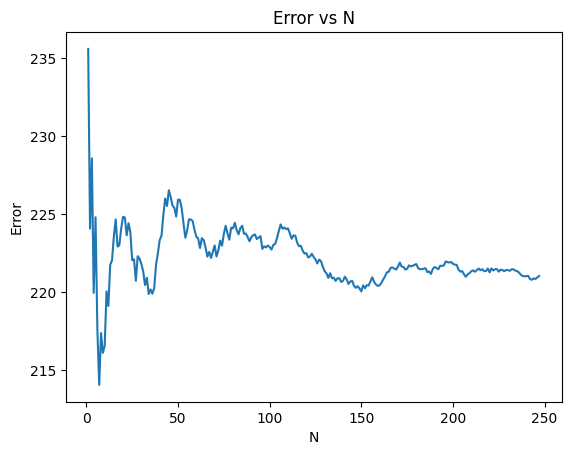

In [473]:
#plot 
plt.plot(range(1, len(RMSE)+1), RMSE)
plt.xlabel('N')
plt.ylabel('Error')
plt.title('Error vs N')
plt.show()

In [476]:
forest.score(X_test_loo, Y_test)

0.9340254695450867

In [477]:
forest.score(X_total_loo, Y_total)

0.840585816198091

In [478]:
forest.score(X_test_loo, Y_test)

0.9340254695450867

In [448]:
forest.score(X_total_loo, Y_total)

0.8975121507692218

In [455]:
# save RF predictions to a file
np.save('predictions_rf_loo_89.npy', F1.predict(X_total_loo))

## Decision Tree

In [607]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV


# grid search with decision tree regressor from sklearn

# param_grid = {
#     'max_depth': np.arange(1, 40),
#     'min_samples_split': np.arange(2, 10),
#     'min_samples_leaf': np.arange(1, 10)
# }

# tree = DecisionTreeRegressor(random_state=seed)

# grid_search = GridSearchCV(tree, param_grid, cv=5, n_jobs=-1, verbose=1)

# grid_search.fit(X_train_loo, Y_train)

# grid_search.best_params_

# tree = DecisionTreeRegressor(random_state=seed, **grid_search.best_params_)
tree = DecisionTreeRegressor(random_state=seed)
tree.fit(X_train_loo, Y_train)

tree.score(X_test_loo, Y_test)

0.8266507142848114

In [610]:
print(df_sorted.columns)
X.columns

Index(['NProc', 'UsedCPUTime', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status',
       'UserID', 'GroupID', 'ExecutableID', 'QueueID', 'OrigSiteID',
       'LastRunSiteID', 'JobStructure', 'JobStructureParams',
       'total_cpu_time'],
      dtype='object')


Index(['NProc', 'UsedMemory', 'ReqNProcs', 'ReqTime', 'Status', 'UserID',
       'GroupID', 'ExecutableID', 'QueueID', 'OrigSiteID', 'LastRunSiteID',
       'JobStructure', 'JobStructureParams'],
      dtype='object')

In [614]:
df_sorted = preprocess_df(df.sort_values(by='SubmitTime'))
X_total_loo = encoder.transform(df_sorted.drop(target, axis=1))
Y_total = df_sorted[target]
tree.score(X_total_loo, Y_total)

0.6692257616722146

In [ ]:
# save config

np.save('predictions_rt_loo_89.npy', tree.predict(X_total_loo))

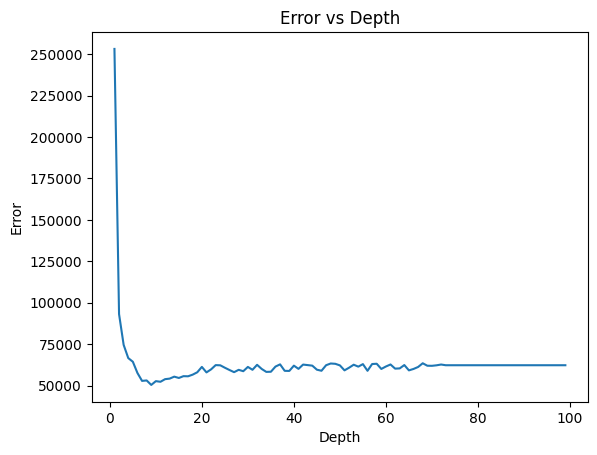

In [421]:
plt.plot(range(1, 100), MSE)
plt.xlabel('Depth')
plt.ylabel('Error')
plt.title('Error vs Depth')
plt.show()

In [422]:
tree.fit(X_train_loo, Y_train)
tree.score(X_test_loo, Y_test)

0.8923522083342679

In [423]:
X_total_loo = encoder.transform(df_processed.drop([target], axis=1))
Y_total = df_processed[target]
tree.score(X_total_loo, Y_total)

0.8632342444805162

In [424]:
#store predictions
predictions = tree.predict(X_total_loo)
np.save('predictions_rt_loo_86.npy', predictions)

#store model
np.save('rt_loo_86.npy', tree)

## XGBoost

## Test 10%

In [657]:
{'gamma': 0.0, 'learning_rate': 0.18999999999999995, 'max_depth': 3, 'n_estimators': 49}

{'gamma': 0.0,
 'learning_rate': 0.18999999999999995,
 'max_depth': 3,
 'n_estimators': 49}

In [702]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', n_estimators=49, max_depth=3, learning_rate=0.19, n_jobs=-1, random_state=seed)
xg_reg.fit(X_train_loo, Y_train)
xg_reg.score(X_test_loo, Y_test)

0.857219458348125

In [704]:
# X_total_loo = encoder.transform(preprocess_df(df.sort_values(by='SubmitTime')).drop([target], axis=1))
# Y_total = df_processed[target]

# df_suffle = df_processed.sample(frac=1, random_state=seed)

# X_total_loo = encoder.transform(df_suffle.drop([target], axis=1))
# Y_total = df_suffle[target]

xg_reg.score(X_total_loo, Y_total)

0.8379431496599934

In [697]:
#store predictions
predictions = xg_reg.predict(X_total_loo)
np.save('predictions_xgboost_loo_88.npy', predictions)

## Test 30,000

In [643]:
help(XGBRegressor)

Help on class XGBRegressor in module xgboost.sklearn:

class XGBRegressor(XGBModel, sklearn.base.RegressorMixin)
 |  XGBRegressor(*, objective: Union[str, Callable[[numpy.ndarray, numpy.ndarray], Tuple[numpy.ndarray, numpy.ndarray]], NoneType] = 'reg:squarederror', **kwargs: Any) -> None
 |
 |  Implementation of the scikit-learn API for XGBoost regression.
 |  See :doc:`/python/sklearn_estimator` for more information.
 |
 |  Parameters
 |  ----------
 |
 |      n_estimators : Optional[int]
 |          Number of gradient boosted trees.  Equivalent to number of boosting
 |          rounds.
 |
 |      max_depth :  Optional[int]
 |          Maximum tree depth for base learners.
 |      max_leaves :
 |          Maximum number of leaves; 0 indicates no limit.
 |      max_bin :
 |          If using histogram-based algorithm, maximum number of bins per feature
 |      grow_policy :
 |          Tree growing policy. 0: favor splitting at nodes closest to the node, i.e. grow
 |          depth-wis

In [382]:
df_processed = get_processed_df()

In [510]:
#xgboost 
import xgboost as xgb
from sklearn.model_selection import train_test_split
import encodings as enc

# df_sample = get_sample(df_processed, 30_000)
# target = 'UsedCPUTime'

# X = df_sample.drop(target, axis=1)
# Y = df_sample[target]

# X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.8)

# X_train_loo, X_test_loo, encoder = encode(X_train, Y_train, X_test, type='leave_one_out')

# X_total_loo = encoder.transform(df_processed.drop(target, axis=1))

#get grid search from scitkit learn

from sklearn.model_selection import GridSearchCV

xg_reg = xgb.XGBRegressor(objective ='reg:squarederror')

parameters = {'n_estimators': range(1, 100), 'max_depth': range(1, 10), 'learning_rate': np.arange(0.05, 1, 0.05)} 

grid = GridSearchCV(xg_reg, parameters, scoring='neg_mean_squared_error', cv=5, n_jobs=-1, verbose=10)


grid.fit(X_train_loo, Y_train)

grid.best_params_

# xg_reg.score(X_total_loo, df_processed[target])

Fitting 5 folds for each of 16929 candidates, totalling 84645 fits


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.01s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0

[CV 4/5; 1/16929] START learning_rate=0.05, max_depth=1, n_estimators=1.........
[CV 2/5; 2/16929] START learning_rate=0.05, max_depth=1, n_estimators=2.........
[CV 3/5; 2/16929] START learning_rate=0.05, max_depth=1, n_estimators=2.........
[CV 5/5; 1/16929] START learning_rate=0.05, max_depth=1, n_estimators=1.........
[CV 5/5; 2/16929] START learning_rate=0.05, max_depth=1, n_estimators=2.........
[CV 1/5; 1/16929] START learning_rate=0.05, max_depth=1, n_estimators=1.........
[CV 2/5; 1/16929] START learning_rate=0.05, max_depth=1, n_estimators=1.........
[CV 4/5; 2/16929] START learning_rate=0.05, max_depth=1, n_estimators=2.........
[CV 3/5; 1/16929] START learning_rate=0.05, max_depth=1, n_estimators=1.........
[CV 1/5; 2/16929] START learning_rate=0.05, max_depth=1, n_estimators=2.........
[CV 4/5; 1/16929] END learning_rate=0.05, max_depth=1, n_estimators=1;, score=-770120.593 total time=   0.0s
[CV 5/5; 2/16929] END learning_rate=0.05, max_depth=1, n_estimators=2;, score=-36

{'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 61}

In [519]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', learning_rate = grid.best_params_['learning_rate'], max_depth = grid.best_params_['max_depth'], n_estimators = grid.best_params_['n_estimators'])

xg_reg.fit(X_train_loo, Y_train)

xg_reg.score(X_test_loo, Y_test)

0.8917863403787525

In [641]:
sampling_seed: int = 1970
seed: int = 1233123

def encode(X_train, Y_train, X_test, type: str = ('leave_one_out', 'target'), **kwargs):
    categorical_columns = X_train.select_dtypes(include='object').columns

    if type == 'leave_one_out':
        encoder = ce.LeaveOneOutEncoder(cols=categorical_columns, return_df=True, **kwargs)
    elif type == 'target':
        encoder = ce.TargetEncoder(cols=categorical_columns, return_df=True)
    else:
        raise ValueError('Invalid type')
    
    X_train = encoder.fit_transform(X_train, Y_train)
    X_test = encoder.transform(X_test)

    return X_train, X_test, encoder

df_sample = df_processed.sample(weights=df_processed.groupby('UsedCPUTime')['UsedCPUTime'].transform('sum'), n=30_000, random_state=sampling_seed)
target = 'UsedCPUTime'

X = df_sample.drop(target, axis=1)
Y = df_sample[target]

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=seed)

encoding = 'leave_one_out'
if encoding == 'leave_one_out':
    args = {'sigma': 0.5, 'random_state': seed}

X_train, X_test, encoder = encode(X_train, Y_train, X_test, type=encoding, **args)

Y_total = df_processed[target]
xg_reg_1 = xgb.XGBRegressor(objective ='reg:squarederror', learning_rate = 0.19, max_depth = 5, n_estimators = 27)

xg_reg_1.fit(X_train, Y_train)

xg_reg_1.score(X_test, Y_test)

0.8597861657513215

In [642]:
X_total_loo = encoder.transform(df_processed.drop(target, axis=1))
Y_total = df_sorted[target]
xg_reg.score(X_total_loo, Y_total)

0.7522279387090042

In [533]:
np.save('predictions_xgboost_loo_89.npy', xg_reg.predict(X_total_loo))

# DF with Target Encoding


In [856]:
sampling_seed: int = 1970

un seed care a functionat bine: 1233123

In [857]:
seed: int = 1233123
# seed: int = 845428

In [858]:
df_sample = df_processed.sample(frac=0.1, weights=df_processed.groupby('UsedCPUTime')['UsedCPUTime'].transform('sum'), random_state=sampling_seed)

In [859]:
#get 80 percent training data
from sklearn.model_selection import train_test_split

target = 'UsedCPUTime'

X = df_sample.drop(target, axis=1)
Y = df_sample[target]

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=seed)

In [860]:
# get the categorical columns
categorical_columns = [column for column in X_train.columns if X_train[column].dtype == 'object']
categorical_columns

['UserID',
 'GroupID',
 'ExecutableID',
 'QueueID',
 'OrigSiteID',
 'LastRunSiteID',
 'JobStructure',
 'JobStructureParams']

In [861]:
import category_encoders as ce
encoder = ce.TargetEncoder(cols=categorical_columns, return_df=True)
X_train_target = encoder.fit_transform(X_train, Y_train)
X_train_target.head()

,NProc,UsedMemory,ReqNProcs,ReqTime,Status,UserID,GroupID,ExecutableID,QueueID,OrigSiteID,LastRunSiteID,JobStructure,JobStructureParams
135278,2,4784.128,2,960.0,1,0.015501,0.789099,0.017372,137.825397,1.274045,1.274045,9.529299,9.529299
924958,2,6307.840,2,600.0,1,0.060639,222.278603,0.072749,137.825397,316.803490,316.803490,9.529299,9.529299
671421,2,12519.424,2,900.0,1,82.534258,0.085231,0.072749,137.825397,27.973623,27.973623,9.529299,9.529299
136244,2,4782.080,2,960.0,1,0.015501,0.789099,0.017372,137.825397,1.274045,1.274045,9.529299,9.529299
57701,1,9555.968,1,960.0,1,0.015501,0.789099,0.017372,137.825397,1.274045,1.274045,9.529299,9.529299


In [862]:
X_train_target.dtypes

NProc                   int64
UsedMemory            float64
ReqNProcs               int64
ReqTime               float64
Status                  int64
UserID                float64
GroupID               float64
ExecutableID          float64
QueueID               float64
OrigSiteID            float64
LastRunSiteID         float64
JobStructure          float64
JobStructureParams    float64
dtype: object

In [864]:
X_test_target = encoder.transform(X_test)

In [863]:
X_total_target = encoder.transform(df_processed.drop(target, axis=1))
Y_total = df_processed[target]

## KNN

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

sol = []
for n in range(1, 100):
    neigh = KNeighborsRegressor(n_neighbors=n).fit(X_train_target, Y_train)
    sol.append(neigh.score(X_test_target, Y_test))
    print(f'K={n}: {sol[-1]}')

K=1: 0.6928041760182893
K=2: 0.7047970792992135
K=3: 0.6432028570408503
K=4: 0.6348459516554165
K=5: 0.635394832745152
K=6: 0.6523675051587415
K=7: 0.6649653392857169
K=8: 0.6756066274486332
K=9: 0.6839346436497888


KeyboardInterrupt: 

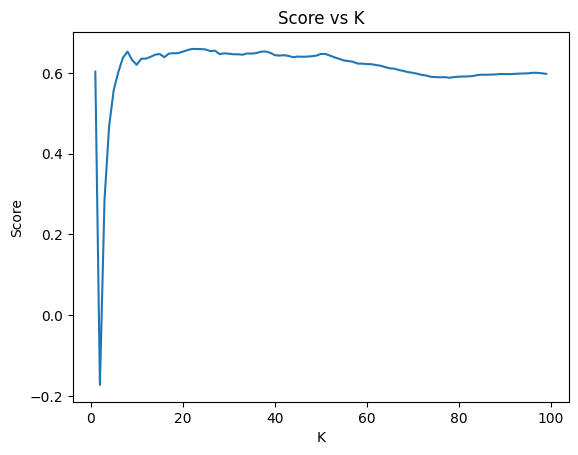

22

In [ ]:
# plot the results
plt.plot(range(1, 100), sol)
plt.xlabel('K')
plt.ylabel('Score')
plt.title('Score vs K')
plt.show()

n = np.argmax(sol) + 1
n

In [ ]:
neigh = KNeighborsRegressor(n_neighbors=5).fit(X_train_target, Y_train)

neigh.score(X_test_target, Y_test)

0.5573867297723137

In [160]:
X_final_target = encoder.transform(df_processed.drop(target, axis=1))
Y_final = df_processed[target]

In [ ]:
neigh.score(X_final_target, Y_final)

0.581965562424333

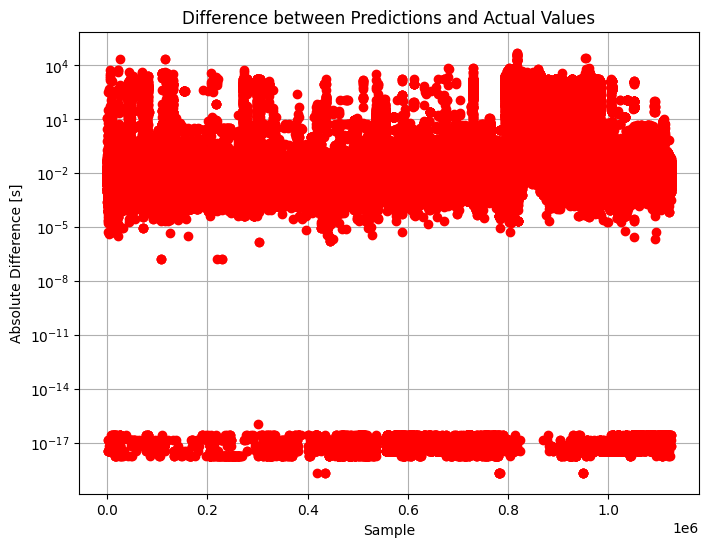

In [ ]:
plot_prediction_differences(neigh, X_final_target, Y_final)

## Random Forests

In [ ]:
from sklearn.ensemble import RandomForestRegressor

sol = []

for n in range(1, 1_000):
    forest = RandomForestRegressor(n_estimators=n, random_state=seed).fit(X_train_target, Y_train)
    sol.append(forest.score(X_test_target, Y_test))
    print(f'n_estimators={n}: {sol[-1]}')

    if n >= 100:
        if sol[-1] - sol[-2] < 1e-8:
            break
    
n = np.argmax(sol) + 1

n_estimators=1: 0.7929163509755144
n_estimators=2: 0.8836596975572646
n_estimators=3: 0.9030233418406747
n_estimators=4: 0.8815089936827935
n_estimators=5: 0.9048931290890279
n_estimators=6: 0.9111229750314749
n_estimators=7: 0.9194203483027447
n_estimators=8: 0.9055080404401207
n_estimators=9: 0.9090384129941573
n_estimators=10: 0.9059344227391393
n_estimators=11: 0.8986832133611388
n_estimators=12: 0.9034290588387083
n_estimators=13: 0.8995340174080912
n_estimators=14: 0.9029516726532566
n_estimators=15: 0.9056043900805749
n_estimators=16: 0.9078962192586997
n_estimators=17: 0.9121958505513731
n_estimators=18: 0.9137017996951663
n_estimators=19: 0.9165939517641629
n_estimators=20: 0.9143277858755918
n_estimators=21: 0.9124714872982018
n_estimators=22: 0.9136996045120243
n_estimators=23: 0.9119304357252832
n_estimators=24: 0.912763715215293
n_estimators=25: 0.9139293109908161
n_estimators=26: 0.9121317164007929
n_estimators=27: 0.909491199253957
n_estimators=28: 0.9067481938044132
n_e

KeyboardInterrupt: 

In [ ]:
n = 25
forest = RandomForestRegressor(n_estimators=n, random_state=seed).fit(X_train_target, Y_train)
n

25

In [ ]:
forest.score(X_test_target, Y_test)

0.9139293109908161

In [ ]:
forest.score(X_final_target, Y_final)

0.8003954875353779

In [ ]:
PREDICTION = forest.predict(X_final_target)

In [ ]:
# save the prediction
np.save('prediction.npy', PREDICTION)

## DecisionTree

In [845]:
import pickle

with open('rt_target_0.926.pkl', 'rb') as file:
    rt_vitorie = pickle.load(file)

print('Sampled data')
print_store_scores(rt_vitorie, X_test_target, Y_test)

print('\nTotal data')
print_store_scores(rt_vitorie, X_total_target, Y_total)

Sampled data
Mean Squared Error: 17170.4008853684
Root Mean Squared Error: 131.0358763292267
Mean Absolute Error: 22.816026733003504
R^2: 0.959569934502762

Total data
Mean Squared Error: 7047.855603998115
Root Mean Squared Error: 83.95150745518579
Mean Absolute Error: 6.824662160785256
R^2: 0.9258535299910214


In [849]:
import pickle
with open('rf_target_0.936.pkl', 'rb') as file:
    rf_vitorie = pickle.load(file)

print('Sampled data')
print_store_scores(rf_vitorie, X_test_target, Y_test)

print('\nTotal data')
print_store_scores(rf_vitorie, X_total_target, Y_total)

Sampled data
Mean Squared Error: 17264.922129323066
Root Mean Squared Error: 131.39605066105702
Mean Absolute Error: 21.33636275721861
R^2: 0.959347371260967

Total data
Mean Squared Error: 6104.45690734449
Root Mean Squared Error: 78.1310239747598
Mean Absolute Error: 6.650614724141012
R^2: 0.9357784897373954


In [851]:
import pickle

with open('xgb_target_0.915.pkl', 'rb') as file:
    xgboost_vitorie = pickle.load(file)

print('Sampled data')
print_store_scores(xgboost_vitorie, X_test_target, Y_test)

print('\nTotal data')
print_store_scores(xgboost_vitorie, X_total_target, Y_total)

Sampled data
Mean Squared Error: 27380.512878322745
Root Mean Squared Error: 165.47058009907002
Mean Absolute Error: 28.1231020076931
R^2: 0.9355288244922765

Total data
Mean Squared Error: 8047.496370769951
Root Mean Squared Error: 89.707838959424
Mean Absolute Error: 9.204226854494836
R^2: 0.9153368794950673


In [ ]:
bun_knn_X_train_loo = X_train_loo
bun_knn_Y_train = Y_train

bun_knn_X_test_loo = X_test_loo
bun_knn_Y_test = Y_test

bun_knn_X_total_loo = X_total_loo
bun_knn_Y_total = Y_total

In [865]:
args_knn = {'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

neigh = KNeighborsRegressor(n_jobs=-1, **args_knn).fit(X_train_target, Y_train)

print('Sampled data')
print_store_scores(neigh, X_test_target, Y_test)

print('\nTotal data')
print_store_scores(neigh, X_total_target, Y_total)

Sampled data
Mean Squared Error: 56205.15992826189
Root Mean Squared Error: 237.07627449464843
Mean Absolute Error: 33.544909032535905
R^2: 0.86765723687216

Total data
Mean Squared Error: 20681.217167322367
Root Mean Squared Error: 143.80965602949743
Mean Absolute Error: 10.496379258555757
R^2: 0.7824247069454504


In [866]:
# save predictions from knn
predictions = neigh.predict(X_total_target)
np.save('predictions_knn_target_0.782.npy', predictions)

In [556]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV

param_grid = {
    'max_depth': np.arange(1, 40),
    'min_samples_split': np.arange(2, 10),
    'min_samples_leaf': np.arange(1, 10)
}

tree = DecisionTreeRegressor(random_state=seed)

grid_search = GridSearchCV(tree, param_grid, cv=5, n_jobs=-1, verbose=10)

grid_search.fit(X_train_target, Y_train)

print(grid_search.best_params_)

tree = DecisionTreeRegressor(random_state=seed, **grid_search.best_params_)
tree.fit(X_train_target, Y_train)

Fitting 5 folds for each of 2808 candidates, totalling 14040 fits


0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0

[CV 1/5; 2/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=3.....
[CV 4/5; 1/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=2.....
[CV 5/5; 2/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=3.....
[CV 2/5; 1/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=2.....
[CV 4/5; 2/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=3.....
[CV 2/5; 2/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=3.....
[CV 1/5; 1/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=2.....
[CV 3/5; 1/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=2.....
[CV 5/5; 1/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=2.....
[CV 1/5; 2/2808] END max_depth=1, min_samples_leaf=1, min_samples_split=3;, score=0.406 total time=   0.0s
[CV 3/5; 2/2808] START max_depth=1, min_samples_leaf=1, min_samples_split=3.....
[CV 5/5; 2/2808] END max_depth=1, min_samples_leaf=1, min_samples_split=3;, score=0

ValueError: Found input variables with inconsistent numbers of samples: [24000, 48000]

In [558]:
Y_test.shape

(24000,)

In [563]:
tree.score(X_test_target, Y_test)

0.8561186895329789

In [562]:
df_sorted = preprocess_df(df.sort_values(by='SubmitTime'))

X_final_target = encoder.transform(df_sorted.drop(target, axis=1))
Y_final = df_sorted[target]

print(tree.score(X_final_target, Y_final))
np.save('predictions_rt_target_64.npy', tree.predict(X_final_target))

0.9306636647254727


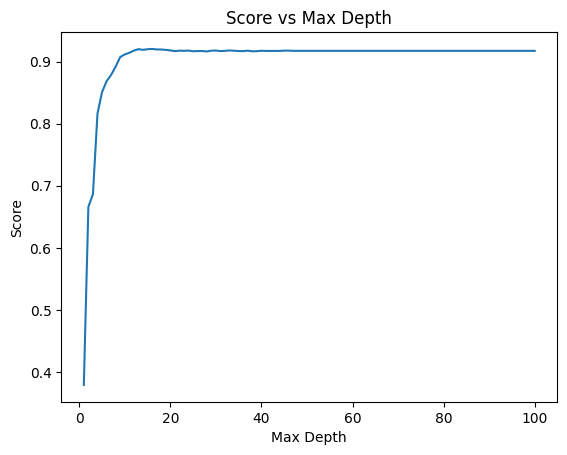

In [ ]:
#plot the results
plt.plot(range(1, len(sol) + 1), sol)
plt.xlabel('Max Depth')
plt.ylabel('Score')
plt.title('Score vs Max Depth')
plt.show()


In [ ]:
tree = DecisionTreeRegressor(max_depth=n, random_state=seed).fit(X_train_target, Y_train)
tree.score(X_test_target, Y_test)

0.9203807357740065

In [ ]:
X_final_target = encoder.transform(df_processed.drop(target, axis=1))
Y_final = df_processed[target]
tree.score(X_final_target, Y_final)

0.8045020083107262

## XGBoost

In [76]:
from xgboost import XGBRegressor

sol = []
mae = []

for n in range(1, 1_000, 1):
    gbr = XGBRegressor(n_estimators=n, random_state=seed)
    gbr.fit(X_train_target, Y_train)
    sol.append(gbr.score(X_test_target, Y_test))
    print(f'N={n}: {sol[-1]}')

    mae.append(np.abs(gbr.predict(X_test_target) - Y_test).mean())
    if n >= 100:
        if np.abs(sol[-1] - sol[-2]) < 1e-8:
            break

gbr = XGBRegressor(n_estimators=n, random_state=seed)

N=1: 0.4418389895853063
N=2: 0.6464959666241776
N=3: 0.750352846415774
N=4: 0.8121870979510091
N=5: 0.8402328192995714
N=6: 0.8597977371061496
N=7: 0.8702597878405727
N=8: 0.8762376559064695
N=9: 0.8810327858263438
N=10: 0.8836336144336627
N=11: 0.8849628894100792
N=12: 0.8880991302067534
N=13: 0.8891518391506594
N=14: 0.890180539491889
N=15: 0.8912501549110738
N=16: 0.8914378022703133
N=17: 0.8923682574406074
N=18: 0.8926793579499841
N=19: 0.8937212546028519
N=20: 0.8939280796882145
N=21: 0.8940785075212365
N=22: 0.8944229808647833
N=23: 0.8945826235997598
N=24: 0.8951130990140479
N=25: 0.895126684640954
N=26: 0.8950972410327336
N=27: 0.895130027354031
N=28: 0.8954173411006108
N=29: 0.8957966435058021
N=30: 0.8958952759379373
N=31: 0.8968883183641894
N=32: 0.8970537646269241
N=33: 0.8969886732790266
N=34: 0.8969796083819236
N=35: 0.897461905867608
N=36: 0.8976017285639568
N=37: 0.8976293036725307
N=38: 0.8976432912510172
N=39: 0.8981402307334535
N=40: 0.8982080605022744
N=41: 0.898322

KeyboardInterrupt: 

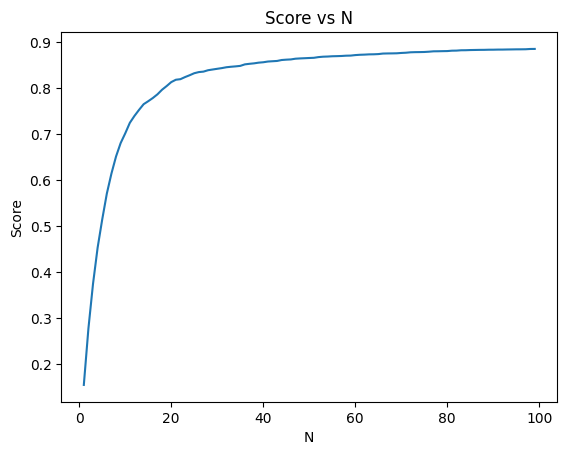

In [ ]:

#plot the results
plt.plot(range(1, len(sol) + 1), sol)
plt.xlabel('N')
plt.ylabel('Score')
plt.title('Score vs N')
plt.show()

In [ ]:
n

99

In [ ]:
gbr = GradientBoostingRegressor(n_estimators=n, criterion='squared_error', random_state=seed)
gbr.fit(X_train_target, Y_train)
gbr.score(X_test_target, Y_test)

0.8850408775287306

Learning Rate=0.01: 0.6941608678254174
Learning Rate=0.02: 0.8066155768761252
Learning Rate=0.03: 0.8407540404009511
Learning Rate=0.04: 0.8575915875715449
Learning Rate=0.05: 0.8661266295127652
Learning Rate=0.060000000000000005: 0.8726842815770457
Learning Rate=0.06999999999999999: 0.8796053554278351
Learning Rate=0.08: 0.8830066534549641
Learning Rate=0.09: 0.8843632374258802
Learning Rate=0.09999999999999999: 0.8850408775287306
Learning Rate=0.11: 0.8899723341607961
Learning Rate=0.12: 0.8930072118758896
Learning Rate=0.13: 0.8938396896948007
Learning Rate=0.14: 0.8956426056996145
Learning Rate=0.15000000000000002: 0.898437700874237
Learning Rate=0.16: 0.8985060535451945
Learning Rate=0.17: 0.8992235684978187
Learning Rate=0.18000000000000002: 0.8986874019785145
Learning Rate=0.19: 0.9025453683876489
Learning Rate=0.2: 0.8968555588830707
Learning Rate=0.21000000000000002: 0.9019380844014451
Learning Rate=0.22: 0.9036962045825496
Learning Rate=0.23: 0.9040040236048182
Learning Rate=

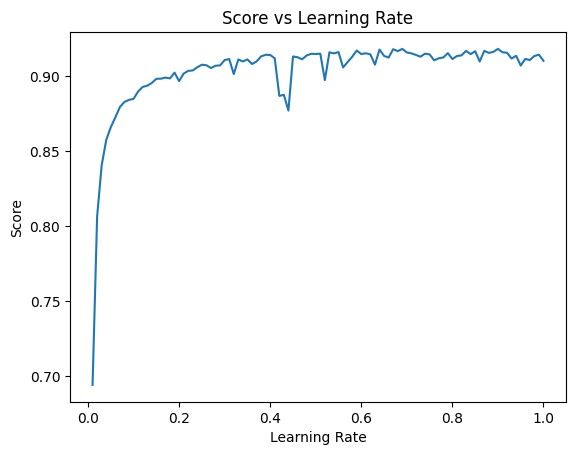

GradientBoostingRegressor(learning_rate=0.9, n_estimators=99,
                          random_state=1233123)

In [ ]:
scores = []
for learning_rate in np.linspace(0.01, 1, 100):
    gbr = GradientBoostingRegressor(n_estimators=n, learning_rate=learning_rate, random_state=seed)
    gbr.fit(X_train_target, Y_train)
    scores.append(gbr.score(X_test_target, Y_test))
    print(f'Learning Rate={learning_rate}: {scores[-1]}')

plt.plot(np.linspace(0.01, 1, 100), scores)
plt.xlabel('Learning Rate')
plt.ylabel('Score')
plt.title('Score vs Learning Rate')
plt.show()

learning_rate = (np.argmax(scores) + 1) * 0.01
gbr = GradientBoostingRegressor(n_estimators=n, learning_rate=learning_rate, random_state=seed)
gbr.fit(X_train_target, Y_train)

In [161]:
from xgboost import XGBRegressor

gbr = XGBRegressor(n_estimators=n, learning_rate=learning_rate, random_state=seed)
gbr.fit(X_train_target, Y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.9, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=14, n_jobs=None,
             num_parallel_tree=None, random_state=1233123, ...)

In [163]:
gbr.score(X_final_target, Y_final)

# save the prediction
np.save('prediction.npy', gbr.predict(X_final_target))

# Draw

In [363]:
# i want you to standardize the data, give me a covariance matrix, and then give me the eigenvalues and eigenvectors of the covariance matrix

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train_target)

X_train_scaled

array([[-0.04952562, -0.10334766, -0.04952562, ..., -0.54866698,
        -0.321476  , -0.15441821],
       [-0.52465482, -0.11282601, -0.52465482, ..., -0.56564929,
        -0.321476  , -0.15441821],
       [-0.52465482, -0.10141242, -0.52465482, ...,  1.97695833,
        -0.321476  , -0.15441821],
       ...,
       [-0.20790202, -0.12067001, -0.20790202, ..., -0.54866698,
        -0.321476  , -0.15441821],
       [-0.52465482, -0.06070438, -0.52465482, ..., -0.54866698,
        -0.321476  , -0.15441821],
       [-0.52465482,  0.07322905, -0.52465482, ...,  1.97695833,
         3.11065212,  3.43406741]])

In [364]:
cov_matrix = np.cov(X_train_scaled.T)

cov_matrix

array([[ 1.00004167e+00, -6.29731984e-02,  1.00004167e+00,
         8.63838924e-04, -3.86161450e-03, -1.08761330e-01,
        -1.07911505e-01, -1.05056050e-01, -6.31154687e-04,
        -1.26246478e-01, -1.26246478e-01, -1.68670962e-01,
        -8.10196356e-02],
       [-6.29731984e-02,  1.00004167e+00, -6.29731984e-02,
         1.76690366e-03,  3.39572290e-03,  1.28246826e-01,
         7.56808877e-02,  1.36098699e-01,  2.81391189e-02,
         1.44559563e-01,  1.44559563e-01,  2.78340836e-01,
         2.14295244e-01],
       [ 1.00004167e+00, -6.29731984e-02,  1.00004167e+00,
         8.63838924e-04, -3.86161450e-03, -1.08761330e-01,
        -1.07911505e-01, -1.05056050e-01, -6.31154687e-04,
        -1.26246478e-01, -1.26246478e-01, -1.68670962e-01,
        -8.10196356e-02],
       [ 8.63838924e-04,  1.76690366e-03,  8.63838924e-04,
         1.00004167e+00,  3.00926744e-04,  6.04087737e-02,
         4.64813128e-03,  1.79320670e-03,  2.68544437e-04,
         1.11361769e-02,  1.11361769e

In [365]:

eigenvalues, eigenvectors = np.linalg.eig(cov_matrix)

eigenvalues

array([ 4.02248010e+00,  1.90367517e+00,  1.33809910e+00,  3.32325687e-01,
        3.87460536e-02,  6.93721323e-01,  6.72349484e-01,  9.73623094e-01,
        1.02420637e+00,  1.00175825e+00,  9.99557060e-01, -3.87646074e-17,
       -8.94436865e-17])

In [366]:
# create a feature vector

feature_vector = eigenvectors[:, 0]

In [368]:
#Recast the Data Along the Principal Components Axes

X_train_pca = X_train_scaled.dot(feature_vector)

/var/folders/3v/wnjt1q_12gn5lscn_jqcbpy40000gn/T/ipykernel_97558/1331096182.py:40: UserWarning: Attempt to set non-positive xlim on a log-scaled axis will be ignored.
  plt.xlim(0, 65)


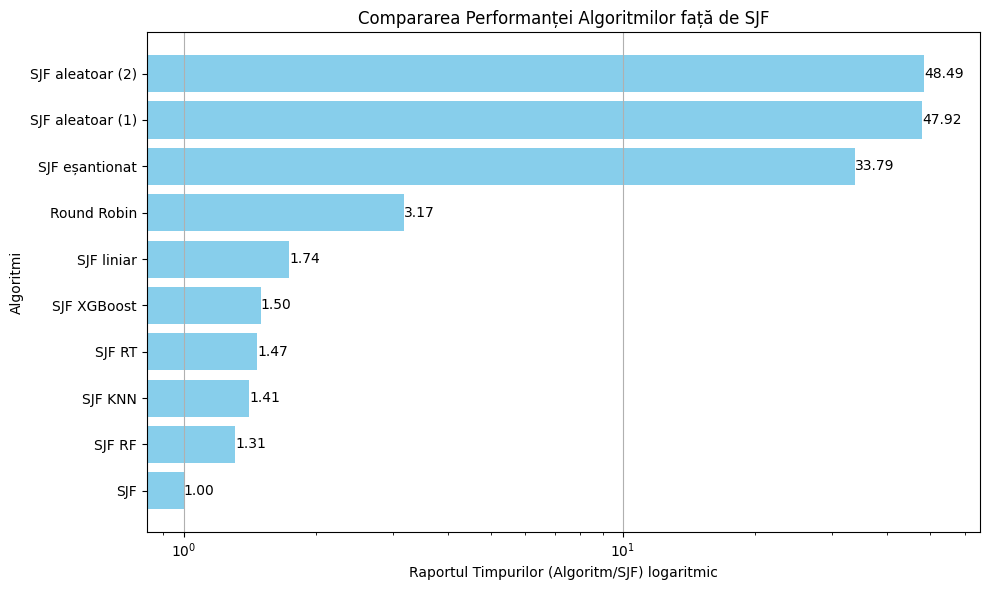

In [868]:
# Numele algoritmilor
algorithms = [
        'SJF',
        'SJF RF',
        'SJF KNN',
        'SJF RT',
        'SJF XGBoost',
        'SJF liniar',
        'Round Robin',
        'SJF eșantionat',
        'SJF aleatoar (1)',
        'SJF aleatoar (2)'
    ]

    # Timpul mediu de execuție
execution_times = [
        51818.34,
        67672.12,
        72832.80,
        76101.23,
        77591.00,
        90041.75,
        164291.85,
        1751086.21,
        2483107.67,
        2512444.46
    ]

    # Raportul timpului (Algoritm/SJF)
time_ratios = [1.00, 1.31, 1.41, 1.47, 1.50, 1.74, 3.17, 33.79, 47.92, 48.49]

    # Crearea graficului
plt.figure(figsize=(10, 6))
plt.barh(algorithms, time_ratios, color='skyblue')
plt.xlabel('Raportul Timpurilor (Algoritm/SJF) logaritmic')
plt.ylabel('Algoritmi')
plt.title('Compararea Performanței Algoritmilor față de SJF')
plt.xscale('log')
plt.grid(axis='x')
plt.xlim(0, 65)

    # Adăugarea valorilor pe bare
for index, value in enumerate(time_ratios):
    plt.text(value, index, f'{value:.2f}', va='center')

plt.tight_layout()
plt.savefig('algorithms_comparison.pdf')
plt.show()

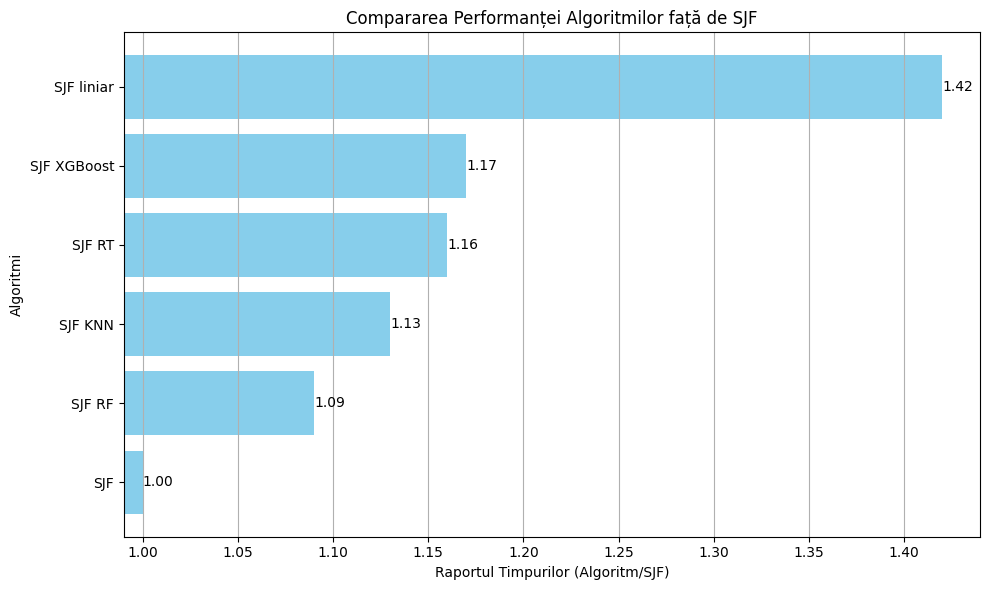

In [879]:
# Numele algoritmilor
algorithms = [
        'SJF',
        'SJF RF',
        'SJF KNN',
        'SJF RT',
        'SJF XGBoost',
        'SJF liniar',
    ]

    # Timpul mediu de execuție
execution_times = [
        51818.34,
        67672.12,
        72832.80,
        76101.23,
        77591.00,
        90041.75,
        164291.85,
        1751086.21,
        2483107.67,
        2512444.46
    ]

    # Raportul timpului (Algoritm/SJF)
time_ratios = [1.00, 1.09, 1.13, 1.16, 1.17, 1.42]

    # Crearea graficului
plt.figure(figsize=(10, 6))
plt.barh(algorithms, time_ratios, color='skyblue')
plt.xlabel('Raportul Timpurilor (Algoritm/SJF)')
plt.ylabel('Algoritmi')
plt.title('Compararea Performanței Algoritmilor față de SJF')
plt.xscale('linear')
plt.grid(axis='x')

    # Adăugarea valorilor pe bare
for index, value in enumerate(time_ratios):
    plt.text(value, index, f'{value:.2f}', va='center')

MARGIN: float = 0.01

plt.xlim(1 - MARGIN, np.max(time_ratios) + 2 * MARGIN)

plt.tight_layout()
plt.savefig('algorithms_comparison-10.png')
plt.show()

## Prediction of the length of the next CPU burst

In [2]:
process_bursts = np.array([6, 4, 6, 4, 13, 13, 13, 13, 13])
tau = [10]

alpha: np.double = .5

for process_time in process_bursts:
    tau.append(alpha * process_time + (1 - alpha) * tau[-1])

tau

[10, 8.0, 6.0, 6.0, 5.0, 9.0, 11.0, 12.0, 12.5, 12.75]

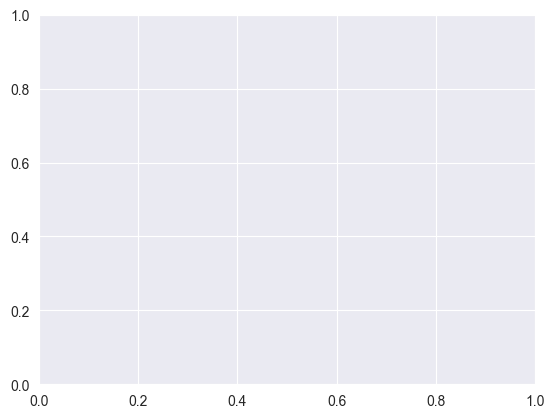

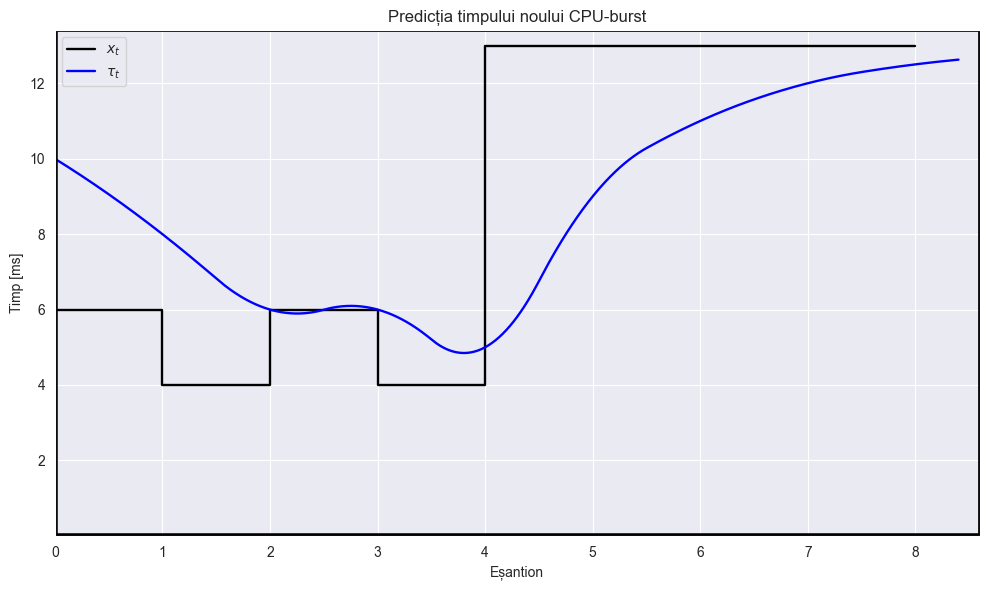

In [3]:
import seaborn as sns
from scipy.interpolate import make_interp_spline

sns.set_style('darkgrid')

plt.grid(True)

MARGIN: np.double = 0.2

plt.figure(figsize=(10, 6))

plt.xticks(range(len(process_bursts)))
plt.yticks(range(2, int(np.max(process_bursts)), 2))

plt.xlim(0, len(process_bursts) - 2 * MARGIN)
plt.ylim(0, np.max(process_bursts) + 2 * MARGIN)

plt.step(range(len(process_bursts)), process_bursts, color='black', linewidth=1.7, where='post', label='$x_t$')

x_tau = np.linspace(0, len(tau) - 1.6, 1_000)

spl = make_interp_spline(range(len(tau)), tau, k=2)
tau_smooth = spl(x_tau)

plt.plot(x_tau, tau_smooth, color='b', linewidth=1.7, label='$\\tau_t$')

# line for Ox
plt.axhline(0, color='black', linewidth=4)
plt.axvline(0, color='black', linewidth=4)

# add top and right lines
plt.axhline(np.max(process_bursts) + 2 * MARGIN, color='black', linewidth=2.7)
plt.axvline(len(process_bursts) - 2 * MARGIN, color='black', linewidth=2.7)

plt.xlabel('Eșantion')
plt.ylabel('Timp [ms]')
plt.legend()

plt.title('Predicția timpului noului CPU-burst')
plt.tight_layout()

plt.savefig('cpu_burst_prediction.pdf')